In [2]:
#!/usr/bin/env Rscript 
library(dplyr)
library(Seurat)
library(SeuratDisk)
library(SeuratData)
library(httr)
library(readr)
library(pheatmap)
library(RColorBrewer)
library(ggplot2)
library(cowplot)
library(patchwork)
library(unixtools)
library(ggrepel)
library(repr)
library(ggmin)
library(harmony)
library(SeuratWrappers)
library(Nebulosa)
library(ggthemes)
library(ComplexHeatmap)
library(scales)
library(pochi)
library(data.table)
set_config(config(ssl_verifypeer = 0L))
ulimit::memory_limit(100000)
set.tempdir("/datastore/lucy/tmp/")
setwd("/datastore/lucy/SynovialAtlas/CD1c")
options(warn = -1, verbose=FALSE)

soft  hard 
1e+05   Inf

In [8]:
mono.mac.dc <- readRDS("/datastore/lucy/SynovialAtlas/CD1c/mono.mac.dc.rds")

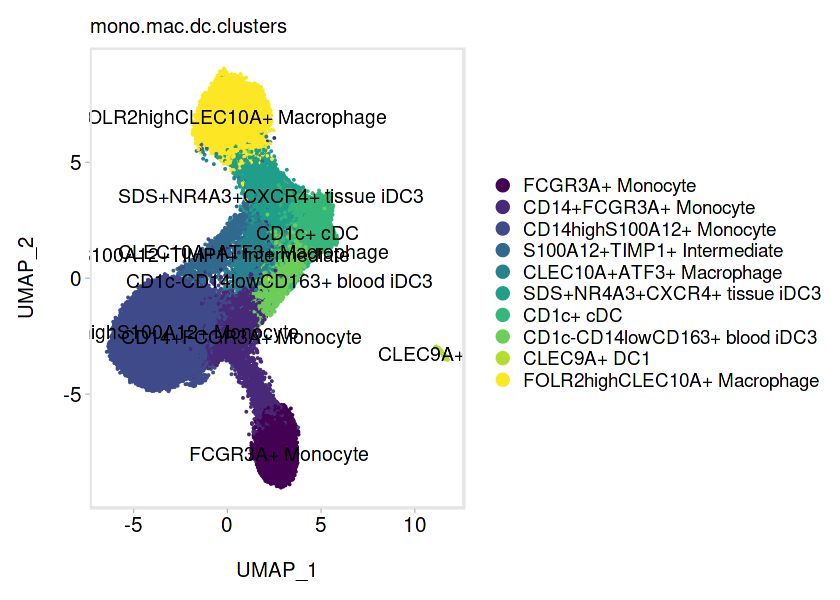

In [9]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(mono.mac.dc, group.by="mono.mac.dc.clusters", label=TRUE) + theme_powerpoint()

In [15]:
cols <- c("darkorchid3","#938AF1",
                  "#EF90D4", "#EB4691","#D2CEF9","yellow", 
      "#B4FF00","#68B731","#00689A","#51F6BC")
names(cols) <- levels(mono.mac.dc$mono.mac.dc.clusters)

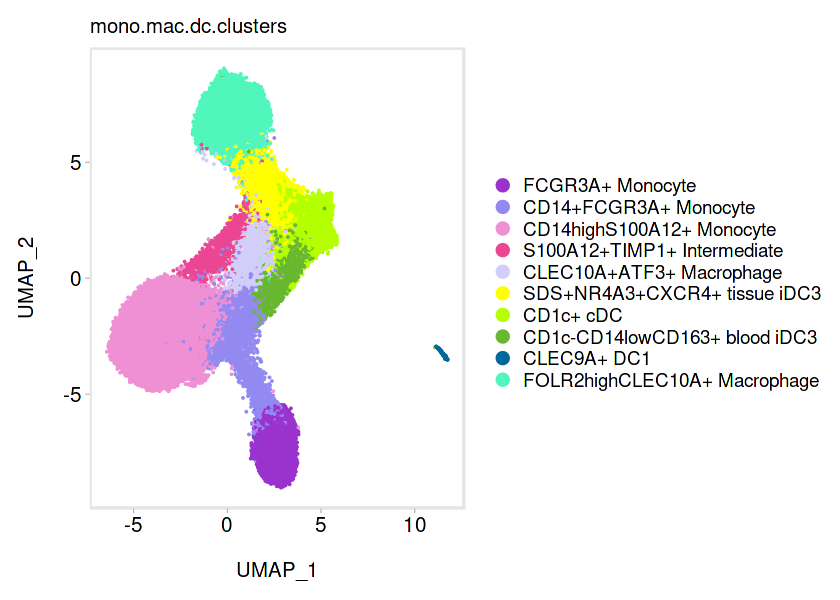

In [16]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(mono.mac.dc, group.by="mono.mac.dc.clusters", cols=cols) + theme_powerpoint()

In [17]:
unique(Idents(mono.mac.dc))

[1] FOLR2highCLEC10A+ Macrophage  SDS+NR4A3+CXCR4+ tissue iDC3 
 [3] CD1c+ cDC                     CD1c-CD14lowCD163+ blood iDC3
 [5] CD14highS100A12+ Monocyte     CLEC10A+ATF3+ Macrophage     
 [7] CD14+FCGR3A+ Monocyte         S100A12+TIMP1+ Intermediate  
 [9] FCGR3A+ Monocyte              CLEC9A+ DC1                  
10 Levels: FCGR3A+ Monocyte CD14+FCGR3A+ Monocyte ... FOLR2highCLEC10A+ Macrophage

## Isolate myeloid cDC clusters of interest

In [13]:
dc.only <- subset(mono.mac.dc, idents=c("CLEC9A+ DC1","SDS+NR4A3+CXCR4+ tissue iDC3","CD1c+ cDC",
                                        "CD1c-CD14lowCD163+ blood iDC3","CLEC9A+ DC1"))

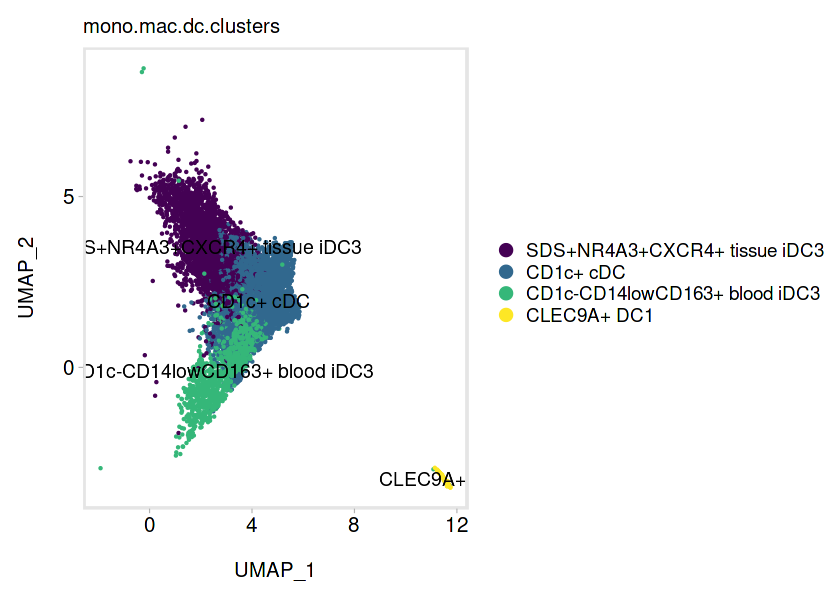

In [14]:
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(dc.only, group.by="mono.mac.dc.clusters", label=TRUE) + theme_powerpoint()

In [18]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(dc.only@meta.data),Embeddings(dc.only, reduction = "umap")[,1], Embeddings(dc.only, reduction = "umap")[,2],
                   dc.only$Tissue,dc.only$condition,dc.only$mono.mac.dc.clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  data.frame(Embeddings(mono.mac.dc, reduction = "umap")[,1], Embeddings(mono.mac.dc, reduction = "umap")[,2])
colnames(allcells) <- c("UMAP1", "UMAP2")
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

In [19]:
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(mono.mac.dc$mono.mac.dc.clusters)))
umap <- umap[order(umap$ID),]

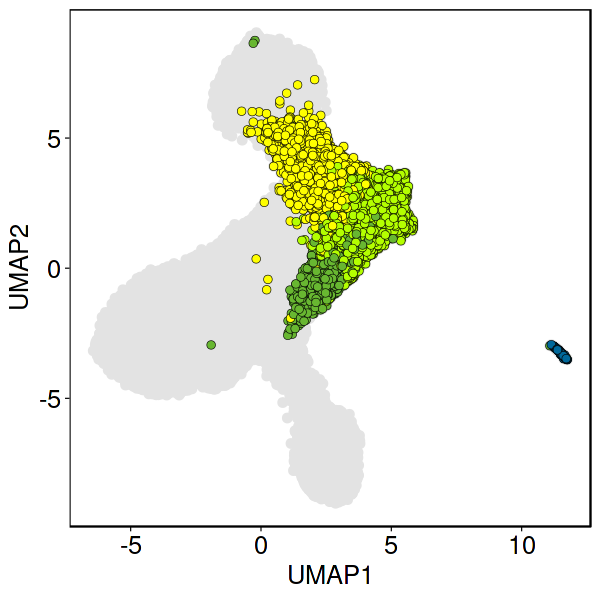

In [22]:
options(repr.plot.width=5, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=2, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=2, shape=21, stroke = 1/5) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

In [36]:
#Continue with typical preprocessing pipeline
dc.only <- dc.only %>%
    NormalizeData() %>%
    FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% 
    ScaleData() %>% RunPCA()

Centering and scaling data matrix

PC_ 1 
Positive:  MT-ATP8, SAMHD1, MATR3, ITGA4, RIPOR2, MT-ND4L, MT-ND5, SELL, ADA2, TXNIP 
	   LCP1, FYB1, RAC2, MT-CO1, POU2F2, ACTR2, SYK, KCTD12, PTEN, PTBP3 
	   CNN2, NREP, MT-ND1, MT-ND4, VCL, MPEG1, SIGLEC14, MT-ATP6, PRKCD, SPN 
Negative:  RPS17, SAT1, LMNA, UBC, FTL, PLAUR, CREM, GPR183, S100A6, GPX1 
	   TIMP1, CRIP1, ALDOA, CD83, CD9, C15orf48, INSIG1, FABP5, SGK1, CTSL 
	   CXCR4, VSIG4, NEAT1, CXCL3, CXCL2, HSPE1, S100A10, ATP1B3, NR4A3, HERPUD1 
PC_ 2 
Positive:  ATP5F1E, ATP5MG, SELENOK, ELOB, RACK1, METRNL, IGKC, NOP53, ATP5F1D, JUND 
	   IGLC2, IGHG3, ATP5MC2, CEBPB, COPS9, ATP5ME, SEM1, IGHM, SELENOS, YBX3 
	   ATP5PO, ELL2, PNRC1, CD81, BTG1, REX1BD, ATP5PF, C5AR1, JPT1, CEBPD 
Negative:  GPX1, ALDOA, HLA-DRB5, ACTB, RPS17, ZNF90, CD52, JUNB, HLA-DQA1, TAP1 
	   CD1C, CD1E, SELL, IL2RG, TUG1, CASP1, MATR3, RAC2, CNN2, CST7 
	   CCL3L3, TCOF1, SPN, CD2, FGR, LY6E, PSME2, ITGB7, NREP, ID2 
PC_ 3 
Positive:  CD14, S100A9, FCGR3A, FCN

In [37]:
#Preintegration
dc.only <- RunUMAP(object = dc.only, reduction = "pca", dims = 1:40)

12:06:52 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:06:52 Read 7869 rows and found 40 numeric columns

12:06:52 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:06:52 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:06:53 Writing NN index file to temp file /datastore/lucy/tmp//file14ba2659689309

12:06:53 Searching Annoy index using 1 thread, search_k = 3000

12:06:55 Annoy recall = 100%

12:06:56 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

12:06:58 Initializing from normalized Laplac

## Visualize UMAP pre-harmonization (integration)

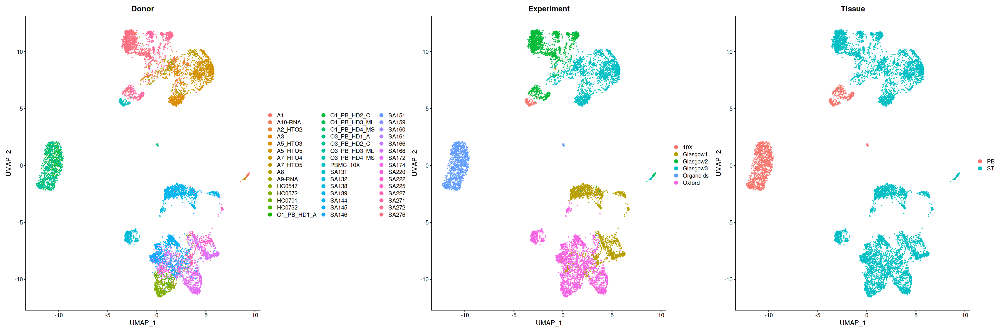

In [38]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(dc.only, group.by=c("Donor","Experiment","Tissue"))

## Integrate with harmony

In [39]:
#Harmonize
dc.only <- dc.only %>% 
   RunHarmony(group.by.vars=c("Donor","Experiment","Tissue","Platform"), theta=c(0,2,0,2))

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony converged after 7 iterations



In [40]:
#Run clustering 
dc.only <- RunUMAP(object = dc.only, reduction = "harmony", dims = 1:20)
dc.only <- FindNeighbors(object = dc.only, reduction = "harmony", dims = 1:20)
dc.only <- FindClusters(dc.only, res=1.5)

12:08:10 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:08:10 Read 7869 rows and found 20 numeric columns

12:08:10 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

12:08:10 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:08:11 Writing NN index file to temp file /datastore/lucy/tmp//file14ba2672aa8a20

12:08:11 Searching Annoy index using 1 thread, search_k = 3000

12:08:13 Annoy recall = 100%

12:08:14 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

12:08:16 Initializing from normalized Laplac

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 7869
Number of edges: 300844

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7616
Number of communities: 20
Elapsed time: 1 seconds


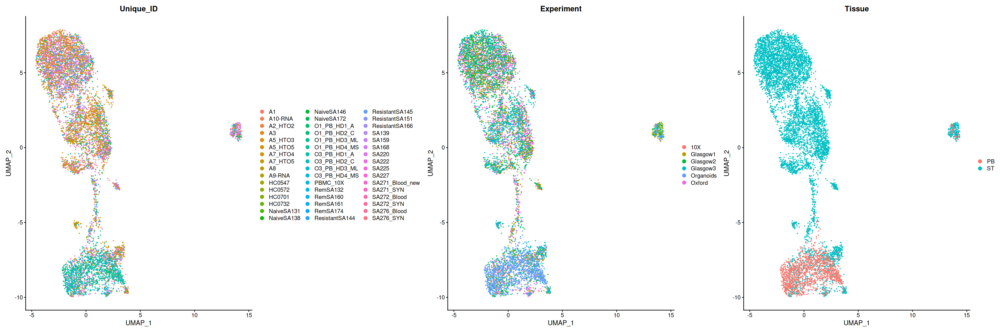

In [41]:
options(repr.plot.width=30, repr.plot.height=10)
DimPlot(dc.only, group.by=c("Unique_ID","Experiment","Tissue"))

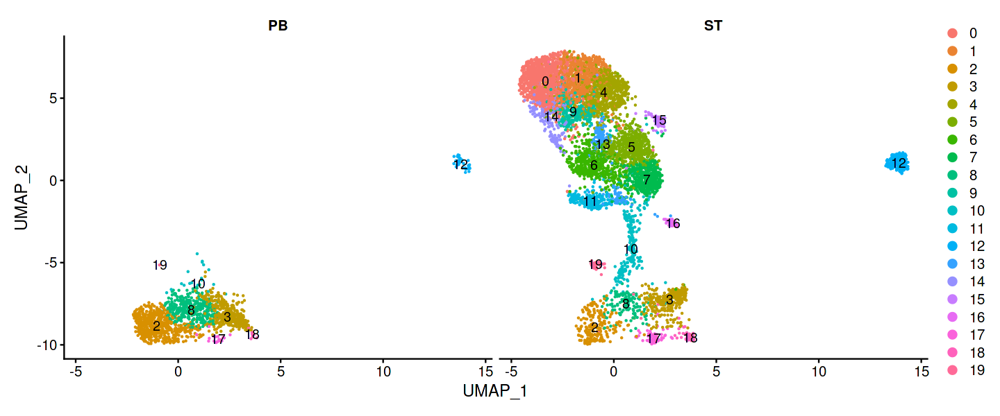

In [42]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(dc.only, split.by=c("Tissue"),label=TRUE)

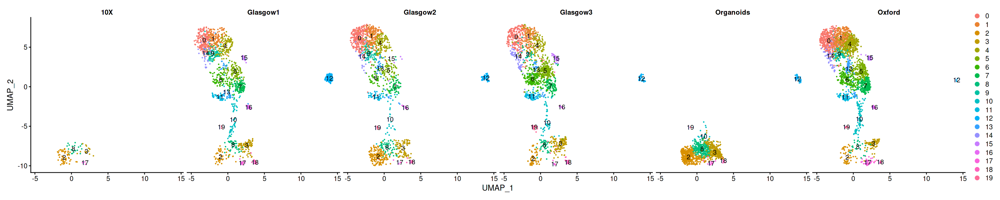

In [43]:
options(repr.plot.width=25, repr.plot.height=5)
DimPlot(dc.only, split.by=c("Experiment"),  label=TRUE)

In [44]:
# options(repr.plot.width=10, repr.plot.height=5)
# DimPlot(dc.only, label="FALSE", cols=rev(c("red","green","blue",rep("grey",24)))) 

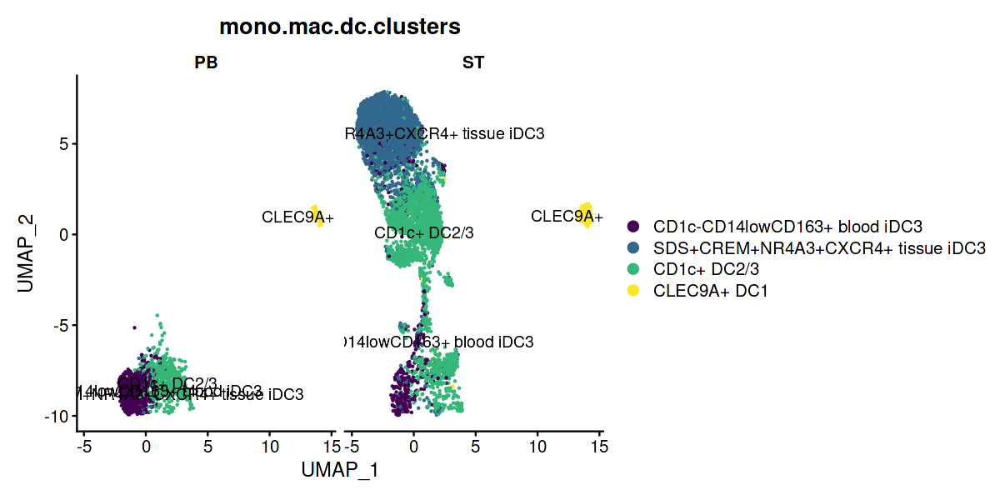

In [45]:
#Previous clustering when with monocytes
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(dc.only, split.by=c("Tissue"), group.by="mono.mac.dc.clusters", label=TRUE)

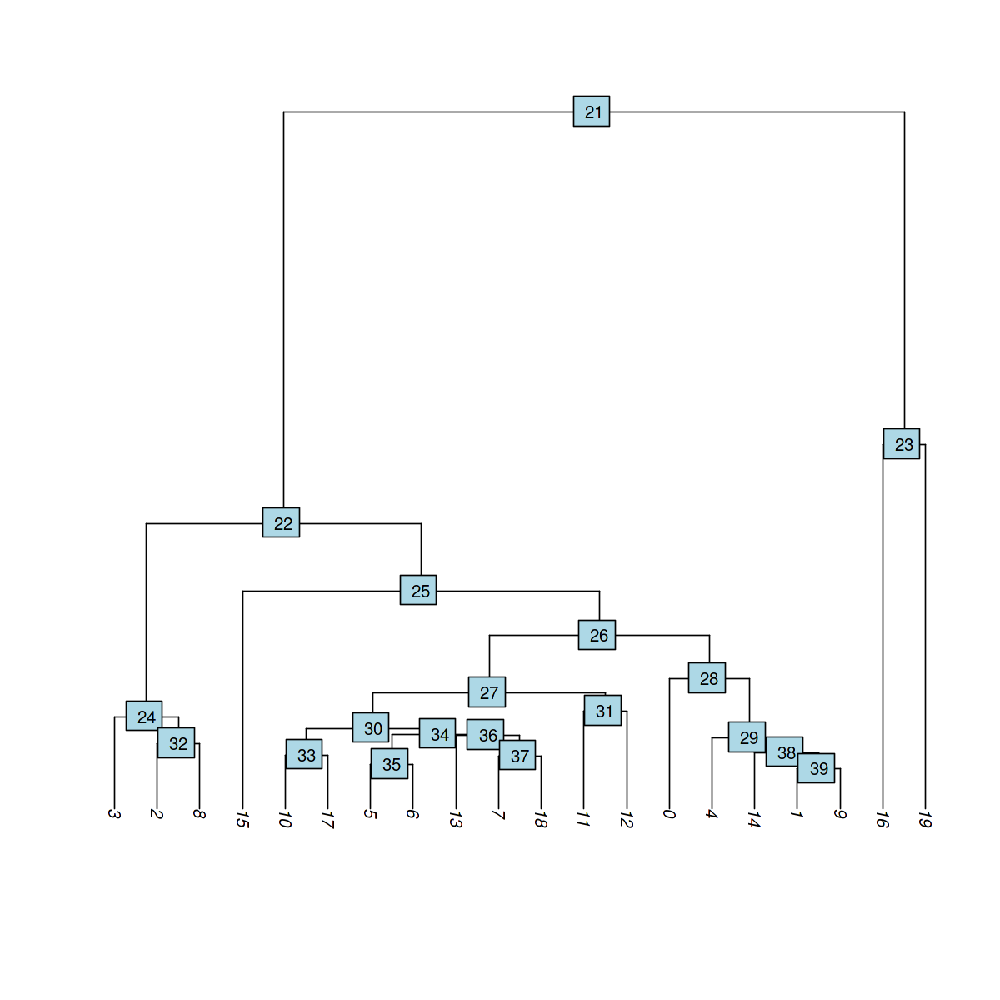

In [46]:
options(repr.plot.width=10, repr.plot.height=10)
BuildClusterTree(dc.only) %>% PlotClusterTree() 

## Cluster distributions per conditon

In [47]:
table(dc.only$seurat_clusters, dc.only$Tissue)

    
      PB  ST
  0    0 986
  1    0 794
  2  559 196
  3  379 323
  4    0 701
  5    0 587
  6    0 526
  7    0 493
  8  344 127
  9    0 291
  10  19 244
  11   0 247
  12  28 216
  13   0 202
  14   0 191
  15   0 103
  16   0  87
  17  20  66
  18   9  68
  19   1  62

In [48]:
dc.only.st <- subset(dc.only, subset=Tissue=="ST")

In [49]:
Idents(dc.only.st) <- "condition"

In [50]:
table(dc.only.st$condition)


     PB_Healthy    PB_Active RA      ST_Healthy    ST_Active RA ST_Remission RA 
              0               0            1373            4105            1032 

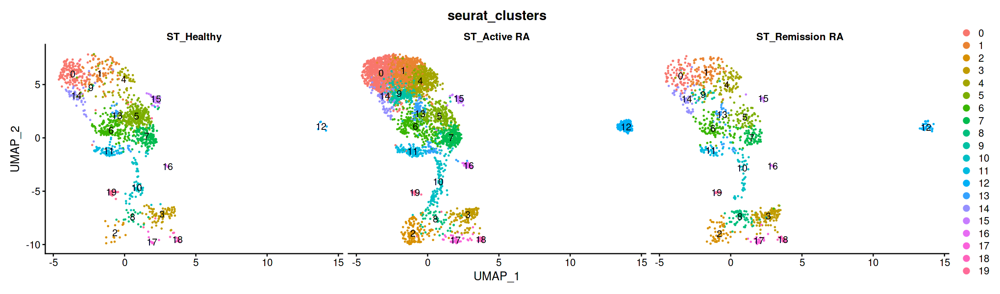

In [51]:
options(repr.plot.width=17, repr.plot.height=5)
DimPlot(dc.only.st, split.by=c("condition"), group.by="seurat_clusters", label=TRUE)

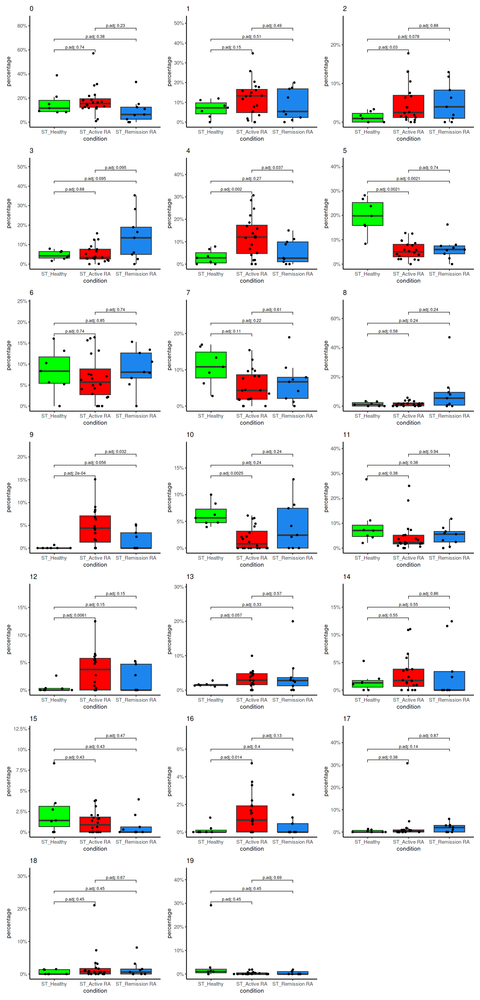

In [52]:
library(pochi)
options(repr.plot.width=12, repr.plot.height=25)
AbundancePlot(dc.only.st, group.by = "seurat_clusters", split.by = "condition", 
              replicate.by = "Unique_ID", perform.stat.test=TRUE,
              fill_colors=c("green", "red", "dodgerblue2"))

## Gene Expression

In [53]:
genes <- c("CD14","FCGR3A","S100A12","ITGAM")

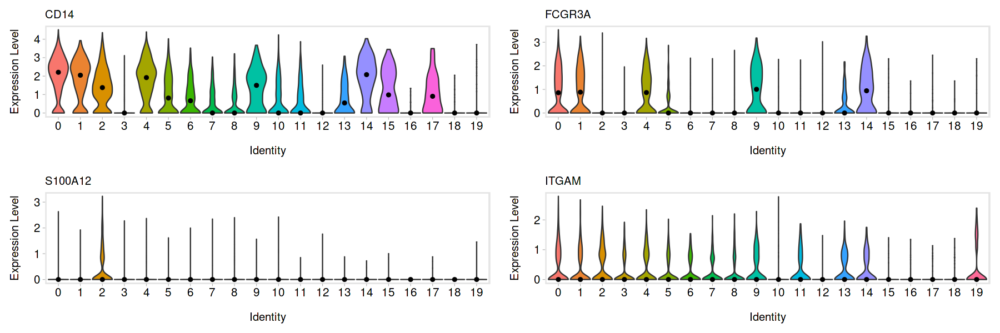

In [54]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

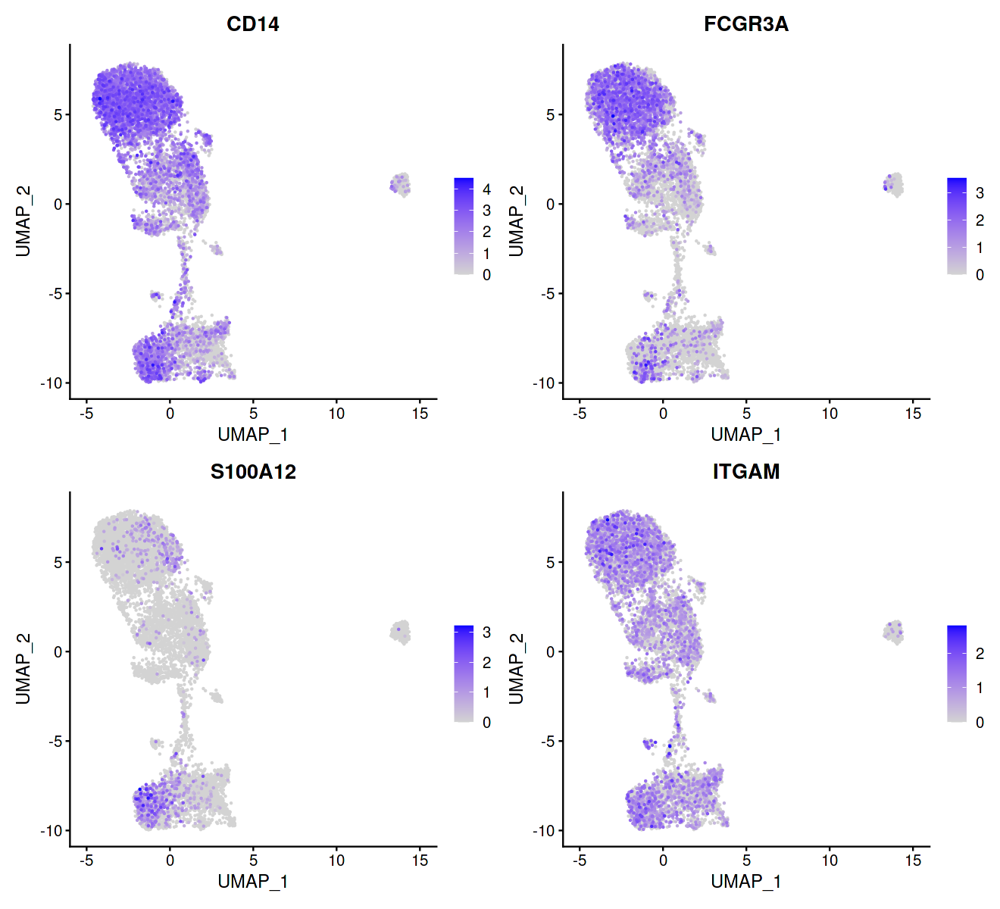

In [55]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

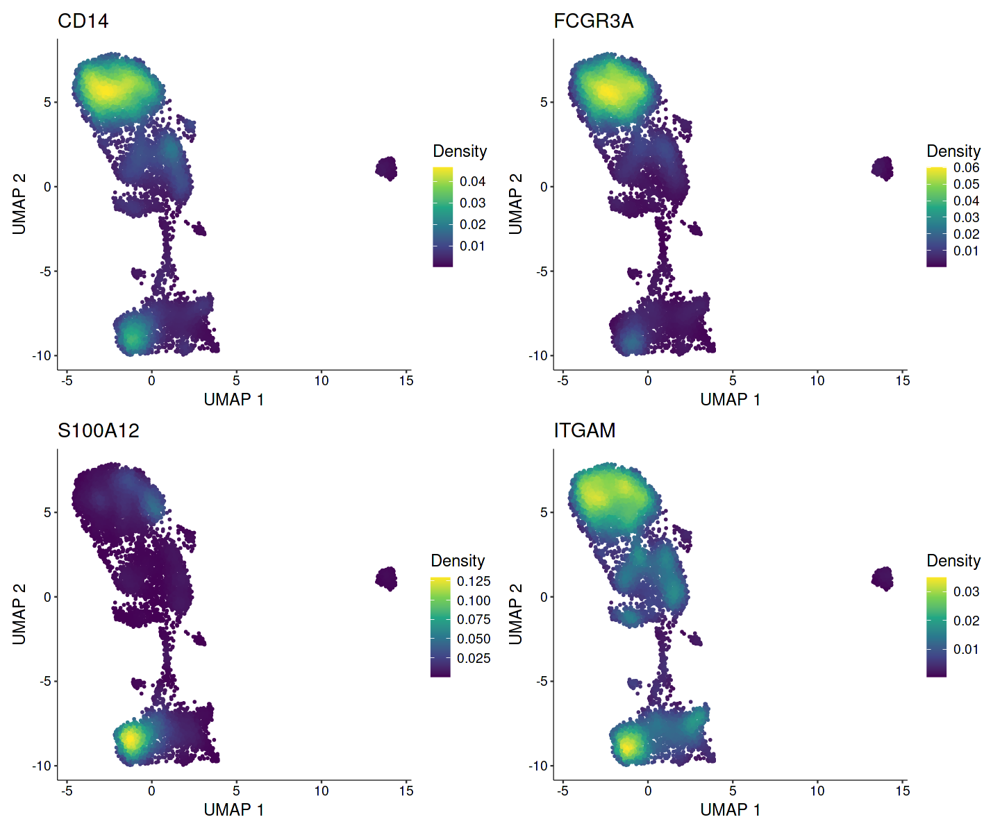

In [56]:
options(repr.plot.width=12, repr.plot.height=10)
plot_density(dc.only, genes, reduction="umap")

In [57]:
genes <- c("CD1C","FCER1A","CLEC10A","ITGAX")

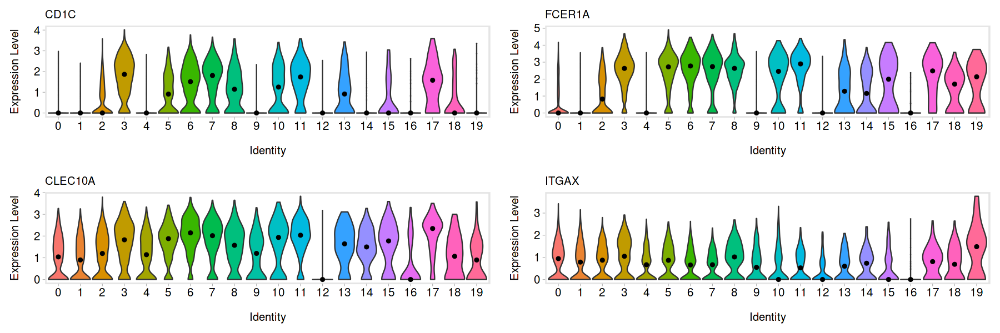

In [58]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

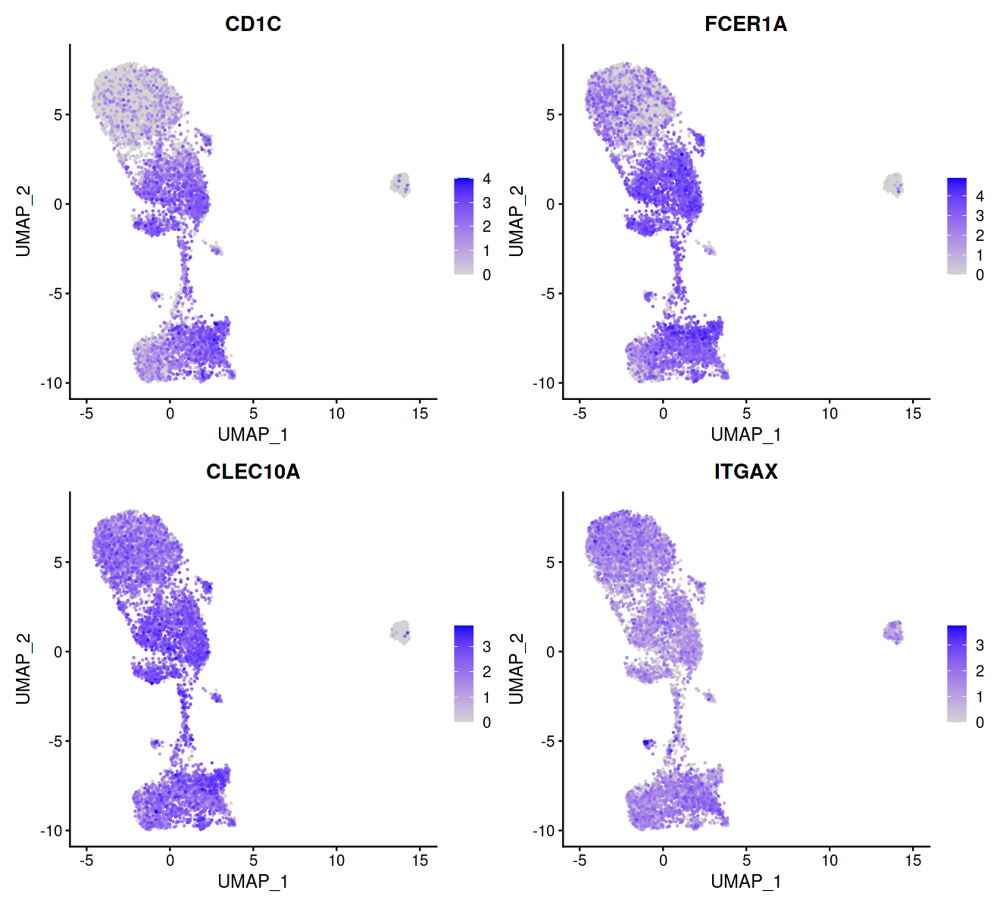

In [59]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

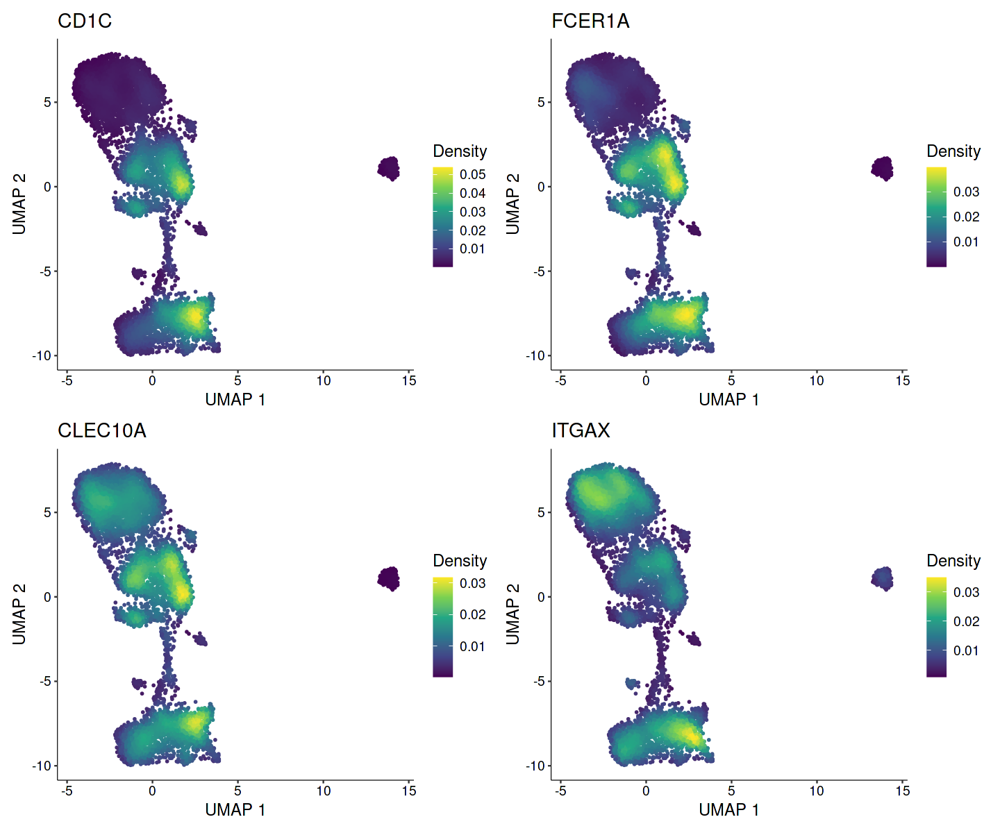

In [60]:
options(repr.plot.width=12, repr.plot.height=10)
plot_density(dc.only, genes, reduction="umap")

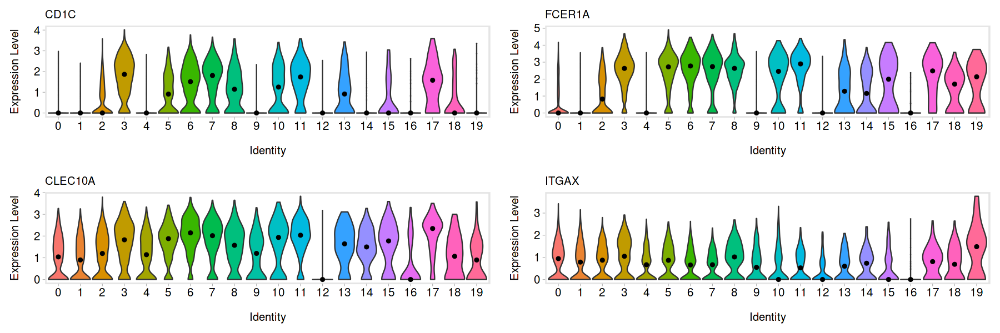

In [61]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

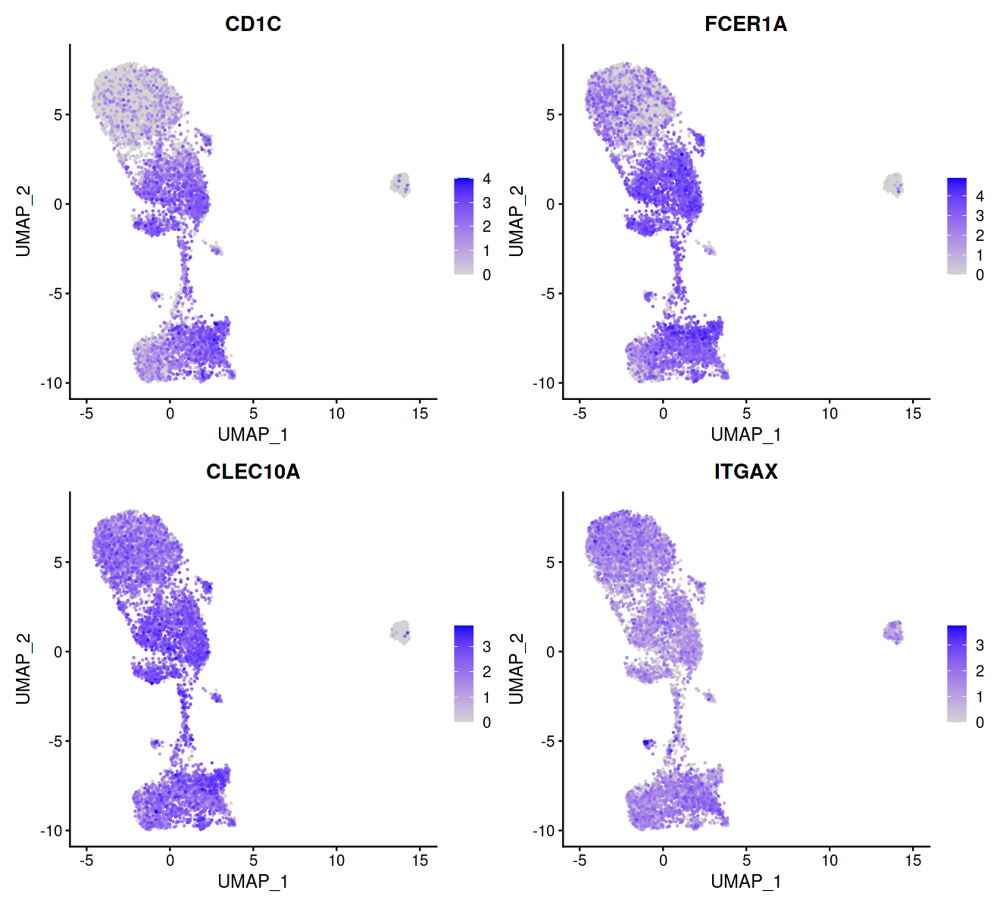

In [62]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

In [63]:
genes <- c("AXL","CXCR4","MRC1","KLF4")

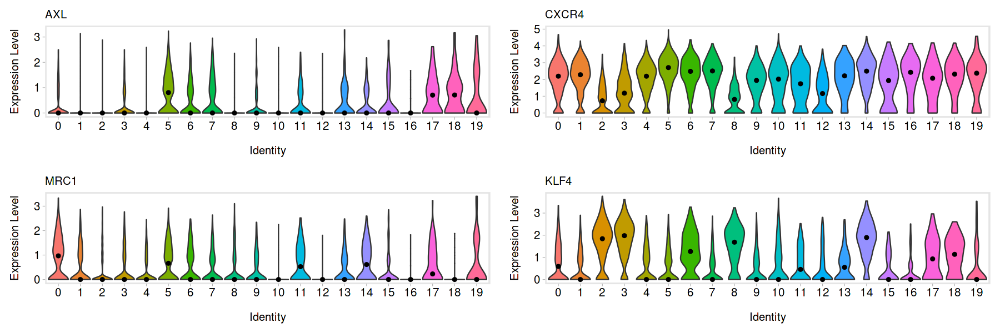

In [64]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

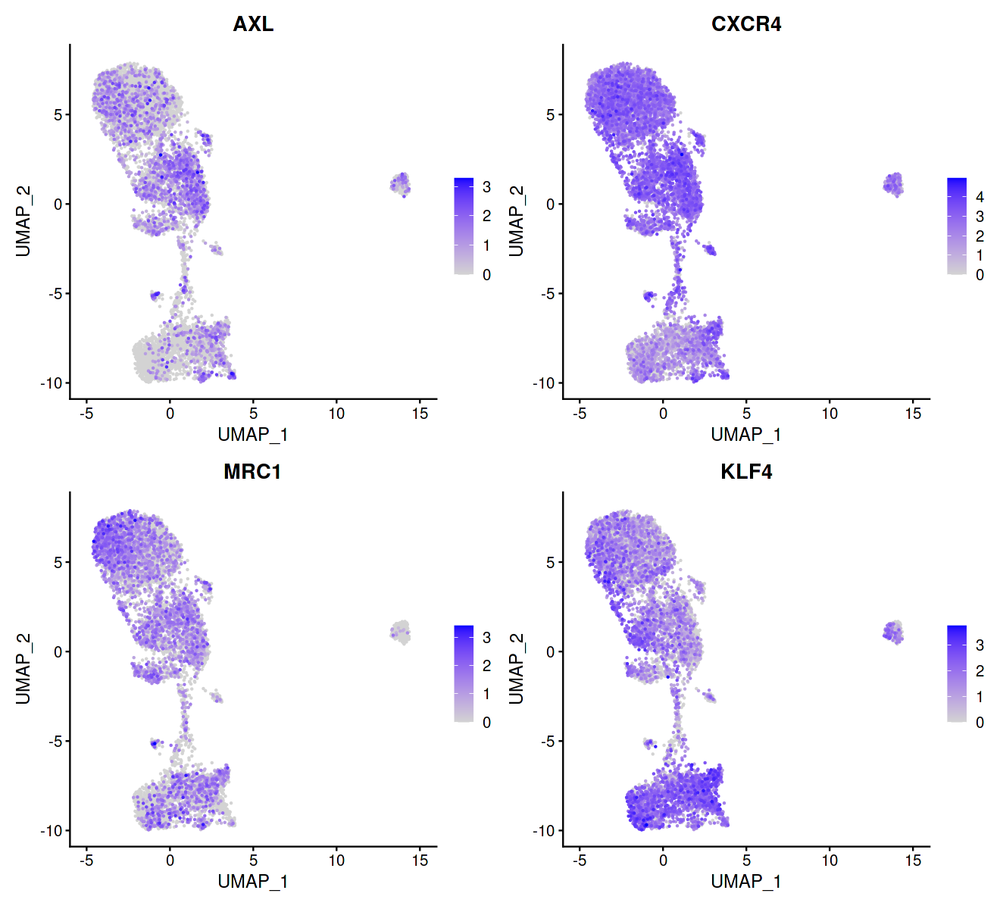

In [65]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

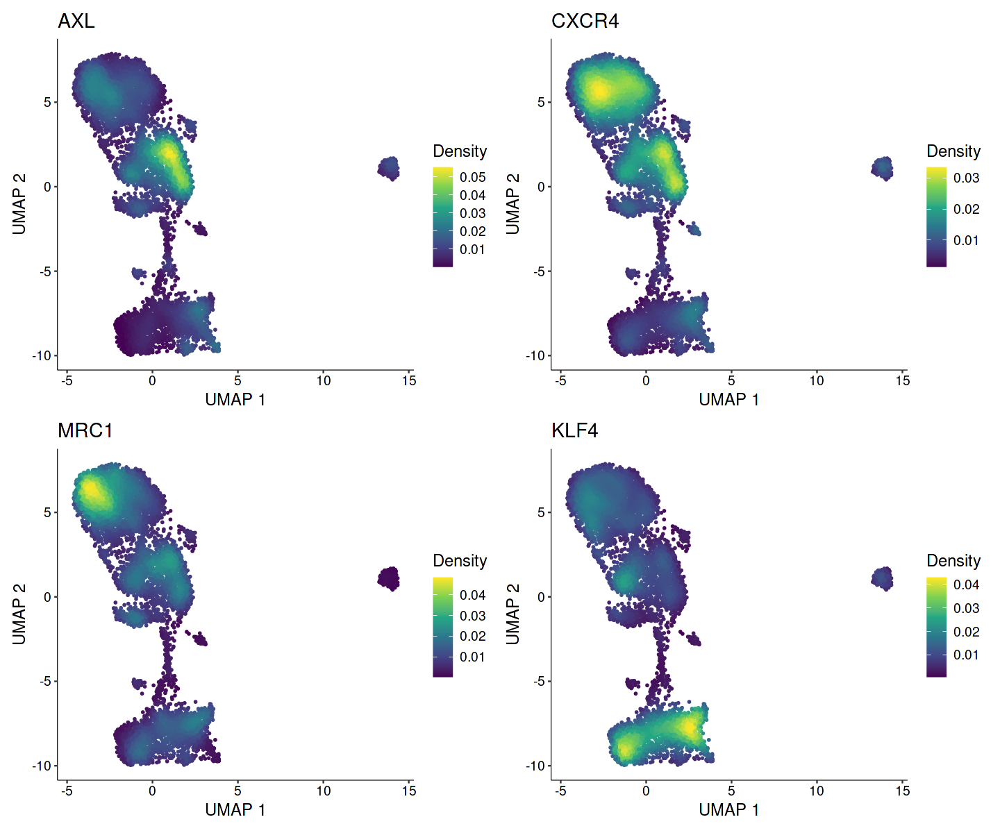

In [66]:
options(repr.plot.width=12, repr.plot.height=10)
plot_density(dc.only, genes, reduction="umap")

In [67]:
genes <- c("CD163","CD36","CD9","CD63")

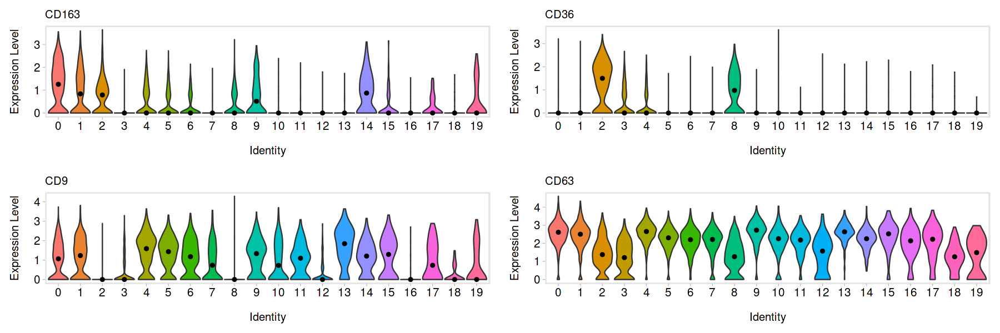

In [68]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

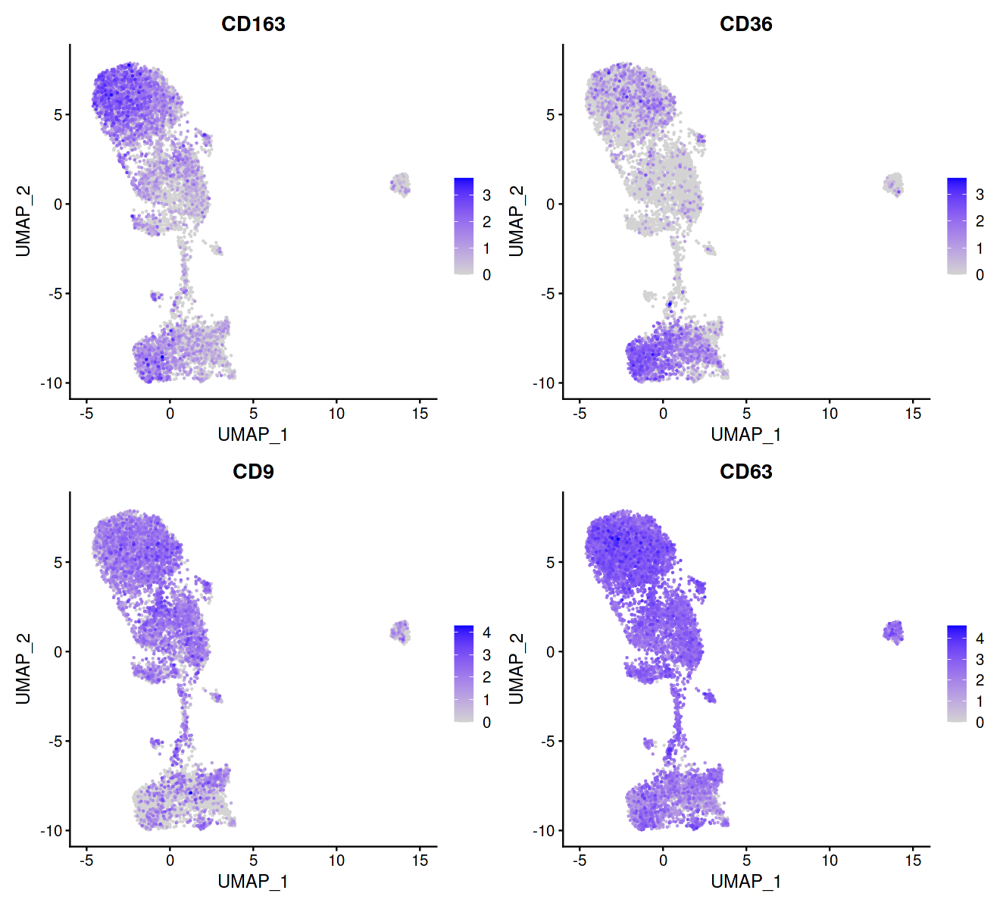

In [69]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

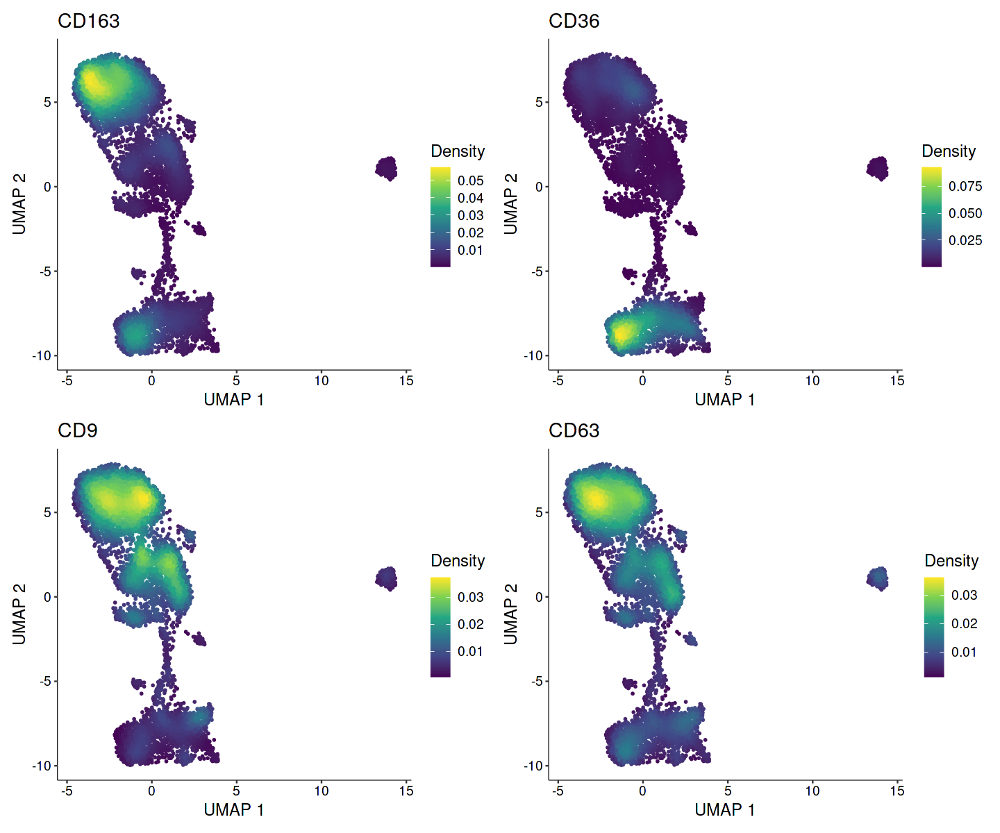

In [70]:
options(repr.plot.width=12, repr.plot.height=10)
plot_density(dc.only, genes, reduction="umap")

In [71]:
genes <- c("CCR7","LAMP3","MIR155HG","CD63")

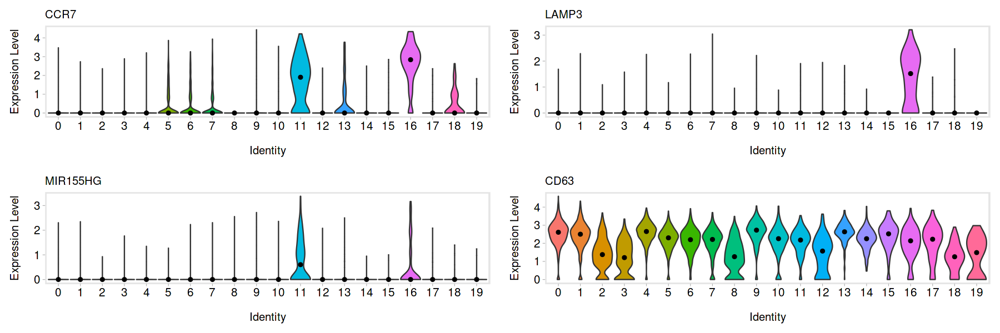

In [72]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_powerpoint() + NoLegend()
}
plot_grid(plotlist=x, ncol=2)

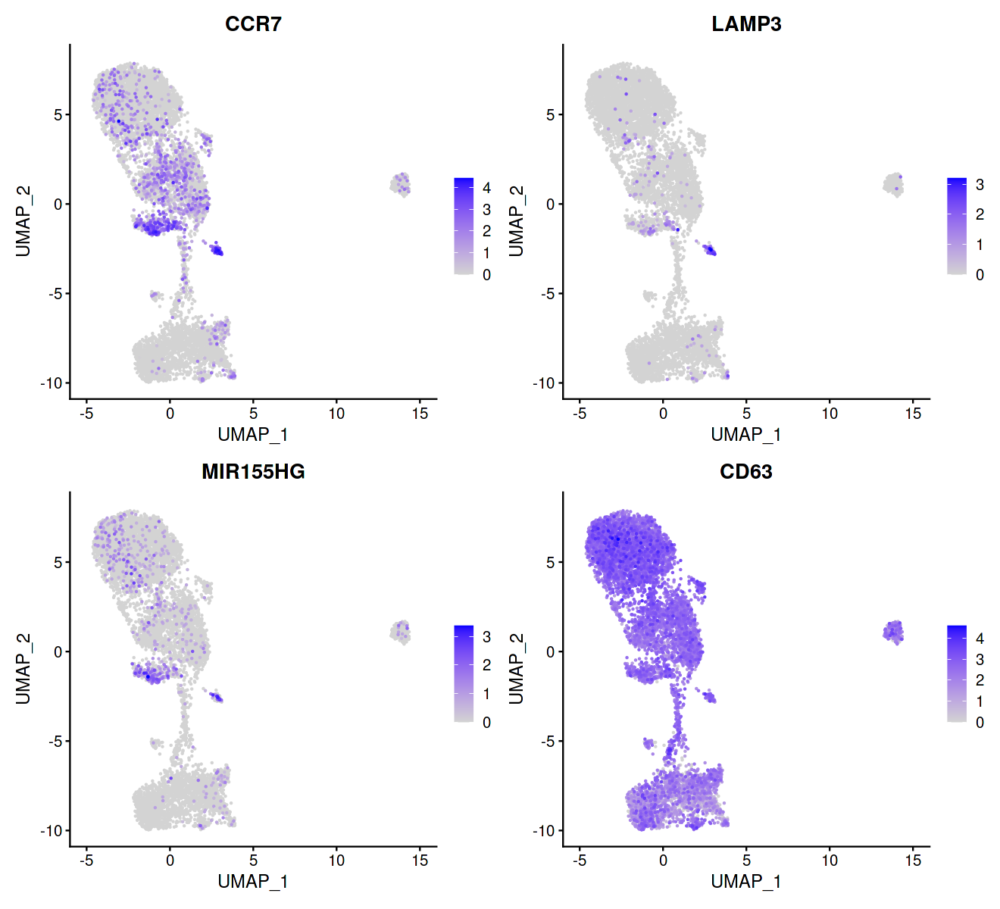

In [73]:
options(repr.plot.width=11, repr.plot.height=10)
FeaturePlot(dc.only, genes, order = TRUE)

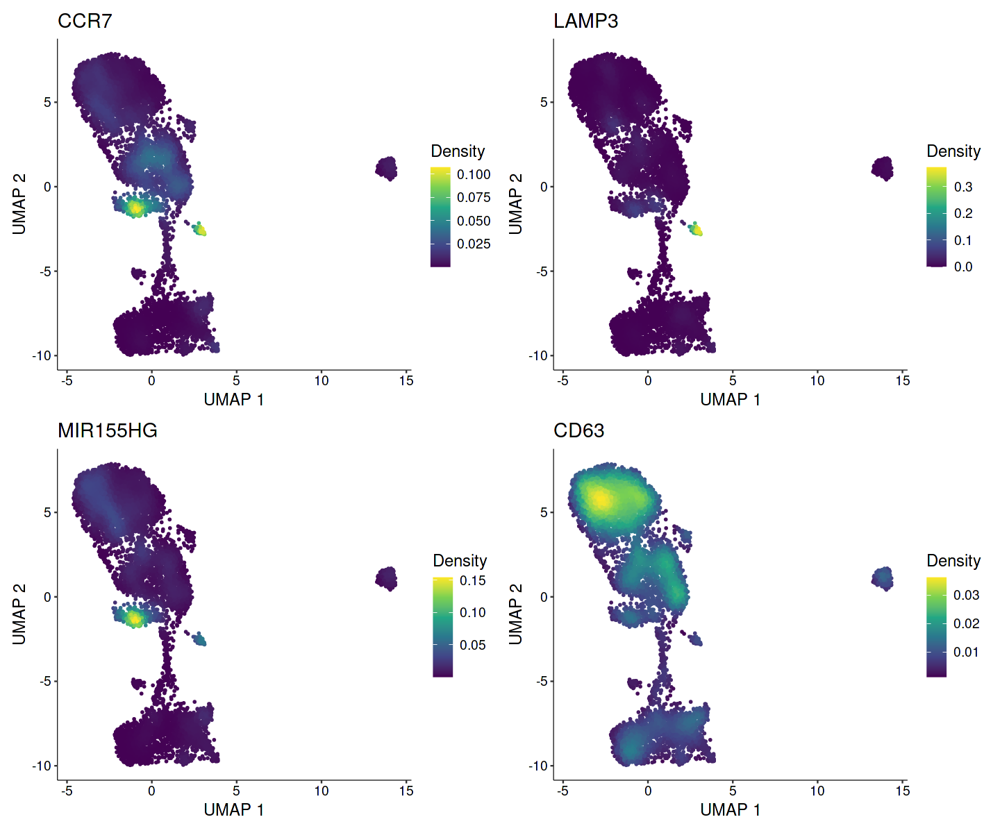

In [74]:
options(repr.plot.width=12, repr.plot.height=10)
plot_density(dc.only, genes, reduction="umap")

In [75]:
unique(colnames(dc.only@meta.data))

[1] "orig.ident"               "nCount_RNA"              
 [3] "nFeature_RNA"             "percent.mt"              
 [5] "percent.hb"               "percent.ribo"            
 [7] "RNA_snn_res.0.1"          "seurat_clusters"         
 [9] "pANN_0.25_0.09_3"         "Doublets.Low.Confidence" 
[11] "Doublets.High.Confidence" "pANN_0.25_0.24_11"       
[13] "pANN_0.25_0.12_2"         "pANN_0.25_0.01_13"       
[15] "pANN_0.25_0.01_9"         "pANN_0.25_0.25_13"       
[17] "pANN_0.25_0.03_9"         "pANN_0.25_0.04_2"        
[19] "pANN_0.25_0.02_4"         "pANN_0.25_0.28_6"        
[21] "pANN_0.25_0.09_10"        "pANN_0.25_0.26_6"        
[23] "pANN_0.25_0.04_5"         "pANN_0.25_0.1_16"        
[25] "pANN_0.25_0.09_1"         "pANN_0.25_0.03_2"        
[27] "Experiment"               "Tissue"                  
[29] "Unique_ID"                "Cont"                    
[31] "pANN_0.25_0.23_447"       "pANN_0.25_0.01_39"       
[33] "pANN_0.25_0.3_98"         "pANN_0.25_0.05_13"       
[35] "pANN_0.25_0.005_101"      "pANN_0.25_0.05_15"       
[37] "pANN_0.25_0.005_86"       "pANN_0.25_0.27_454"      
[39] "pANN_0.25_0.3_52"         "pANN_0.25_0.09_662"      
[41] "pANN_0.25_0.005_744"      "pANN_0.25_0.005_680"     
[43] "pANN_0.25_0.26_674"       "pANN_0.25_0.12_500"      
[45] "nCount_ADT"               "nFeature_ADT"            
[47] "Name.exp"                 "Tagging"                 
[49] "SampleID"                 "Condition"               
[51] "Exp"                      "pANN_0.25_0.03_8"        
[53] "pANN_0.25_0.27_27"        "HTO"                     
[55] "HTO_status"               "pANN_0.25_0.27_1"        
[57] "pANN_0.25_0.15_346"       "pANN_0.25_0.005_291"     
[59] "SNP_cluster"              "SNP_status"              
[61] "pANN_0.25_0.12_5"         "pANN_0.25_0.04_4"        
[63] "pANN_0.25_0.14_20"        "pANN_0.25_0.21_39"       
[65] "pANN_0.25_0.3_2"          "celltype"                
[67] "group"                    "condition"               
[69] "Donor"                    "Platform"                
[71] "Cell_Type_Experimental"   "Sample_Tag"              
[73] "Sample_Name"              "pANN_0.25_0.28_305"      
[75] "pANN_0.25_0.22_29"        "pANN_0.25_0.09_135"      
[77] "Origin"                   "platform"                
[79] "RNA_snn_res.0.6"          "lowDoublets"             
[81] "highDoublets"             "RNA_snn_res.0.5"         
[83] "RNA_snn_res.2"            "RNA_snn_res.1.5"         
[85] "clusters"                 "RNA_snn_res.1.2"         
[87] "RNA_snn_res.1"            "sample"                  
[89] "integrated.clusters"      "integrated.pb.clusters"  
[91] "tissue_condition"         "all.myeloid.clusters"    
[93] "subgroup"                 "replicate"               
[95] "mono.mac.dc.clusters"

In [5]:
dc.only <- readRDS("dc.only.rds")

In [6]:
#Rename your clusters by celltype
Idents(dc.only) <- "RNA_snn_res.1.5"
dc.only$clusters <- plyr::revalue(as.character(Idents(dc.only)),
                                        c("0" = "iDC3 CD1c-CLEC10A+FOLR2++C1QA+",
                                         "1"="iDC3 CD1c-FABP5+SDS+",
                                         "2"="iDC3 CD1c-CD14lowCD163+ (infiltrating)",
                                         "3"="DC2 CD1c++KLF4+ (infiltrating)",
                                         "4"="DC3 CD1clowCD63+CD9+",
                                         "5"="DC2 CD1c++AXL+",
                                         "6"="DC2 CD1c++KLF4+ATF3+MRC1+",
                                         "7"="DC2 CD1c++AXL+",
                                         "8"="DC3 CD1c+CD14-CD163+ (infiltrating)",
                                         "9"="iDC3 CD1c-FABP5+SDS+",
                                         "10"="DC2/3 CD1c+CRIP1+ (transitional)",
                                         "11"="DC2 MIR155HG+CCR7+ (activated)",
                                         "12"="DC1 CLEC9A+ (infiltrating)",
                                         "13"="DC2 CD1c++KLF4+ATF3+MRC1+",
                                         "14"="iDC3 CD1c-CLEC10A+FOLR2++C1QA+",
                                         "15"="DC3 CD1clowTUBB4B+TIMP1+",
                                         "16"="DC2 CCR7+LAMP3+ (migratory)",
                                         "17"="DC2/3 CD1c+ISG15+",
                                         "18"="pre-DC CD5+AXL+SIGLEC6+",
                                         "19"="iDC3 CD1c-CLEC10A+NR4A3+"))

cols <- c("#7FCDF3",
  "#00689A",                    
"#0ec2a2",
          "#43f782",
  "#a6ffef",
  "#e5befb",
  "#C876F7",
  
  "#fdf0bb",
  "#faf771",
  "#fae071",
  "#F8A640",
  "#e38208",
  "#FF6C67",
  "#FF070A",
  "#ce0062",
          "#f776e6"
)
dc.only$clusters <- as.ordered(factor(dc.only$clusters, 
                                      levels=c('pre-DC CD5+AXL+SIGLEC6+',
                                               'DC1 CLEC9A+ (infiltrating)',
                                               'DC2 CD1c++AXL+',
                                               'DC2 CD1c++KLF4+ATF3+MRC1+',
                                                'DC2 CD1c++KLF4+ (infiltrating)',
                                               'DC2 MIR155HG+CCR7+ (activated)',
                                               'DC2 CCR7+LAMP3+ (migratory)',
                                               'DC2/3 CD1c+CRIP1+ (transitional)',
                                               "DC2/3 CD1c+ISG15+",
                                               'DC3 CD1c+CD14-CD163+ (infiltrating)',
                                               'DC3 CD1clowCD63+CD9+',
                                               'DC3 CD1clowTUBB4B+TIMP1+',
                                               'iDC3 CD1c-CD14lowCD163+ (infiltrating)',
                                               'iDC3 CD1c-FABP5+SDS+',
                                               'iDC3 CD1c-CLEC10A+FOLR2++C1QA+',
                                              'iDC3 CD1c-CLEC10A+NR4A3+')))
Idents(dc.only) <- "clusters"

In [7]:
dc.only$dc.type <- plyr::revalue(as.character(Idents(dc.only)),
                                        c("iDC3 CD1c-CLEC10A+FOLR2++C1QA+"="iDC3",
                                         "iDC3 CD1c-FABP5+SDS+"="iDC3",
                                        "iDC3 CD1c-CD14lowCD163+ (infiltrating)"="iDC3",
                                         "DC2 CD1c++KLF4+ (infiltrating)"="DC2",
                                         "DC3 CD1clowCD63+CD9+"="DC3",
                                         "DC2 CD1c++AXL+"="DC2",
                                         "DC2 CD1c++KLF4+ATF3+MRC1+"="DC2",
                                         "DC3 CD1c+CD14-CD163+ (infiltrating)"="DC3",
                                         "DC2/3 CD1c+CRIP1+ (transitional)"="DC3",
                                         "DC2 MIR155HG+CCR7+ (activated)"="DC2",
                                         "DC1 CLEC9A+ (infiltrating)"="DC1",
                                         "DC3 CD1clowTUBB4B+TIMP1+"="DC3",
                                         "DC2 CCR7+LAMP3+ (migratory)"="DC2",
                                         "DC2/3 CD1c+ISG15+"="DC3",
                                         "pre-DC CD5+AXL+SIGLEC6+"="pre-DC",
                                         "iDC3 CD1c-CLEC10A+NR4A3+"="iDC3"))

In [8]:
unique(dc.only$clusters)

[1] iDC3 CD1c-FABP5+SDS+                  
 [2] iDC3 CD1c-CLEC10A+FOLR2++C1QA+        
 [3] DC2 CD1c++AXL+                        
 [4] DC2 CD1c++KLF4+ATF3+MRC1+             
 [5] DC2/3 CD1c+CRIP1+ (transitional)      
 [6] DC2 MIR155HG+CCR7+ (activated)        
 [7] DC2 CD1c++KLF4+ (infiltrating)        
 [8] iDC3 CD1c-CD14lowCD163+ (infiltrating)
 [9] pre-DC CD5+AXL+SIGLEC6+               
[10] DC3 CD1clowTUBB4B+TIMP1+              
[11] DC3 CD1clowCD63+CD9+                  
[12] iDC3 CD1c-CLEC10A+NR4A3+              
[13] DC2/3 CD1c+ISG15+                     
[14] DC3 CD1c+CD14-CD163+ (infiltrating)   
[15] DC1 CLEC9A+ (infiltrating)            
[16] DC2 CCR7+LAMP3+ (migratory)           
16 Levels: pre-DC CD5+AXL+SIGLEC6+ ... iDC3 CD1c-CLEC10A+NR4A3+

In [9]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15))

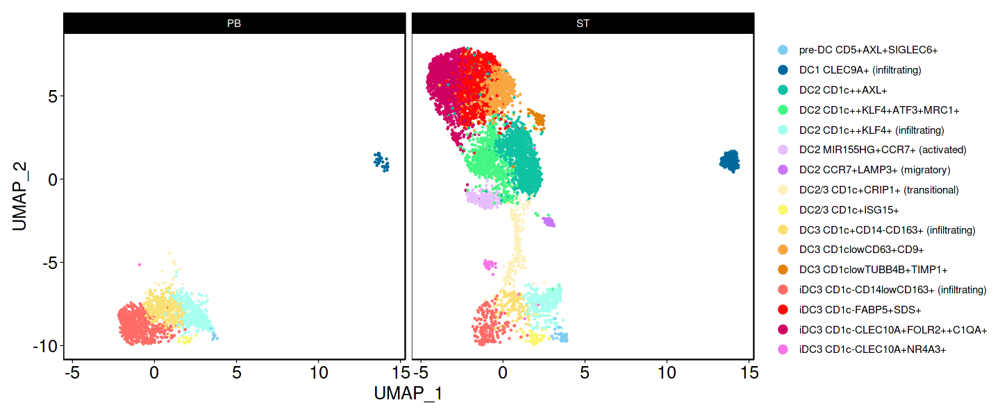

In [7]:
options(repr.plot.width=12, repr.plot.height=5)
DimPlot(dc.only, split.by=c("Tissue"), cols=cols) + theme_specific

In [82]:
cluster.markers <- FindAllMarkers(dc.only, test.use="MAST", min.pct=0.4)
cluster.markers <- cluster.markers[which(cluster.markers$p_val_adj<0.05),]

Calculating cluster pre-DC CD5+AXL+SIGLEC6+


 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 fail

In [86]:
saveRDS(dc.only, "dc.only.rds")

In [5]:
top20 <- cluster.markers %>%
    group_by(cluster) %>%
    slice_max(n = 20, order_by = avg_log2FC)

In [13]:
unique(Idents(dc.only))

[1] iDC3 CD1c-FABP5+SDS+                  
 [2] iDC3 CD1c-CLEC10A+FOLR2++C1QA+        
 [3] DC2 CD1c++AXL+                        
 [4] DC2 CD1c++KLF4+ATF3+MRC1+             
 [5] DC2/3 CD1c+CRIP1+ (transitional)      
 [6] DC2 MIR155HG+CCR7+ (activated)        
 [7] DC2 CD1c++KLF4+ (infiltrating)        
 [8] iDC3 CD1c-CD14lowCD163+ (infiltrating)
 [9] pre-DC CD5+AXL+SIGLEC6+               
[10] DC3 CD1clowTUBB4B+TIMP1+              
[11] DC3 CD1clowCD63+CD9+                  
[12] iDC3 CD1c-CLEC10A+NR4A3+              
[13] DC2/3 CD1c+ISG15+                     
[14] DC3 CD1c+CD14-CD163+ (infiltrating)   
[15] DC1 CLEC9A+ (infiltrating)            
[16] DC2 CCR7+LAMP3+ (migratory)           
16 Levels: pre-DC CD5+AXL+SIGLEC6+ ... iDC3 CD1c-CLEC10A+NR4A3+

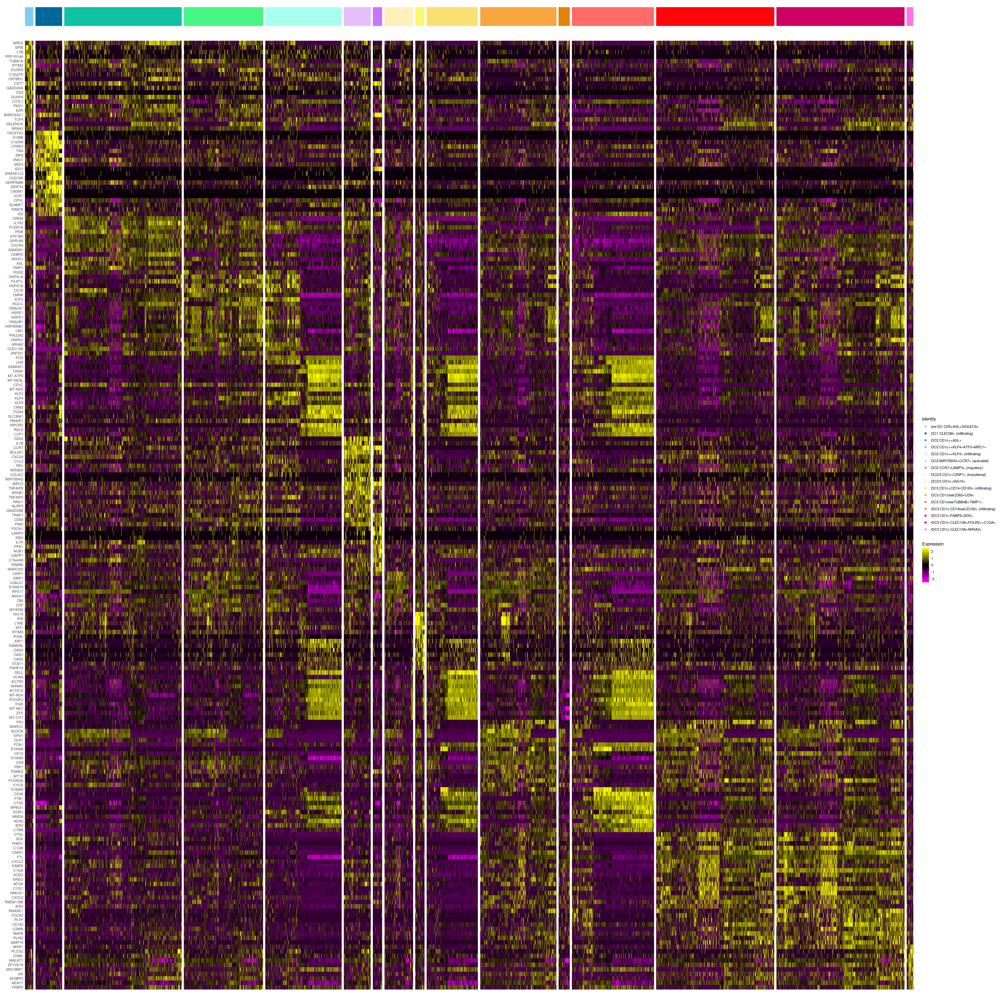

In [14]:
options(repr.plot.width=35, repr.plot.height=35)
DoHeatmap(dc.only, features=top20$gene, group.colors=cols, label=FALSE) 

In [15]:
dc.only

An object of class Seurat 
19143 features across 7869 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

In [36]:
library(data.table)
# pick signficant genes to show in the heatmap
# arrange the genes such that the gene with max logFC is at the center and values decrease as we move away from center
genes_use_df<-data.table(cluster.markers)[
    p_val_adj < 0.05][
    , .SD[order(-avg_log2FC)][1:20, ], by = cluster][
    , .SD[!is.na(gene)]][
    , .SD[order(avg_log2FC)], by = cluster][
    , ":=" (len = .N, rank = frank(avg_log2FC)), by = cluster][
    , .SD[c(seq(1, round(.SD$len[1]/3), 1), seq(.SD$len[1], round(.SD$len[1]/3)+1, -1)), ], by = cluster][
    , .(gene, avg_log2FC, cluster, p_val_adj) 
]

In [86]:
#Organise genes we want to include by cluster
genes_use_df <- genes_use_df %>% distinct(gene, .keep_all = TRUE) %>% arrange(cluster)

In [87]:
head(genes_use_df)

gene,avg_log2FC,cluster,p_val_adj
<chr>,<dbl>,<fct>,<dbl>
NR4A3,0.9222663,pre-DC CD5+AXL+SIGLEC6+,1.661085e-05
SELENOK,0.9238247,pre-DC CD5+AXL+SIGLEC6+,1.170850e-02
TCF4,0.9385050,pre-DC CD5+AXL+SIGLEC6+,1.146234e-02
EZR,0.9766396,pre-DC CD5+AXL+SIGLEC6+,2.505684e-10
PNO1,1.0170694,pre-DC CD5+AXL+SIGLEC6+,7.345945e-13
COTL1,1.0486588,pre-DC CD5+AXL+SIGLEC6+,7.581930e-11


In [88]:
message("Checking that the genes are unique: ", nrow(genes_use_df) == length(unique(genes_use_df$gene)))
message("Number of genes in heatmap: ", nrow(genes_use_df))

# select the top 5 genes with highest logFC in each cluster and assign each gene to a cell type based on it logFC - the gene belongs to the celltype with higher logFC
genes_to_mark_celltypes<-genes_use_df[, .SD[order(-avg_log2FC)][1:3, ], by = cluster][
    , .(cluster, gene)
]

.mat<-cluster.markers %>% 
    subset(gene %in% genes_use_df$gene) %>% 
    dplyr::select(cluster, avg_log2FC, gene) %>% 
    tidyr::spread(cluster, avg_log2FC) %>% 
    tibble::column_to_rownames('gene') %>% 
    as.matrix()    
.mat<-.mat[genes_use_df$gene,]

message(
    "Are all genes that are being marked also present in the matrix?: ", 
    length(setdiff(genes_to_mark_celltypes$gene, colnames(.mat))) == 0
)

Checking that the genes are unique: TRUE

Number of genes in heatmap: 247

Are all genes that are being marked also present in the matrix?: FALSE



In [89]:
genes_use_df[genes_use_df$cluster=="iDC3 CD1c-CD14lowCD163+ (infiltrating)",]

gene,avg_log2FC,cluster,p_val_adj
<chr>,<dbl>,<fct>,<dbl>
CYBB,1.359051,iDC3 CD1c-CD14lowCD163+ (infiltrating),1.161526e-216
IER2,1.362188,iDC3 CD1c-CD14lowCD163+ (infiltrating),2.889622e-164
ADA2,1.396355,iDC3 CD1c-CD14lowCD163+ (infiltrating),3.695482e-181
MNDA,1.398467,iDC3 CD1c-CD14lowCD163+ (infiltrating),5.942100e-253
S100A9,2.362541,iDC3 CD1c-CD14lowCD163+ (infiltrating),7.102409e-192
S100A8,2.263954,iDC3 CD1c-CD14lowCD163+ (infiltrating),1.738819e-197
JUN,1.967229,iDC3 CD1c-CD14lowCD163+ (infiltrating),1.443336e-222
CD36,1.785876,iDC3 CD1c-CD14lowCD163+ (infiltrating),2.923201e-294
FYB1,1.715310,iDC3 CD1c-CD14lowCD163+ (infiltrating),1.524172e-271


In [90]:
genes_to_mark_celltypes

cluster,gene
<fct>,<chr>
pre-DC CD5+AXL+SIGLEC6+,AREG
pre-DC CD5+AXL+SIGLEC6+,SPIB
pre-DC CD5+AXL+SIGLEC6+,LTB
DC1 CLEC9A+ (infiltrating),TACSTD2
DC1 CLEC9A+ (infiltrating),S100B
DC1 CLEC9A+ (infiltrating),C1orf54
DC2 CD1c++AXL+,IL1R2
DC2 CD1c++AXL+,PKIB
DC2 CD1c++AXL+,GPAT3


In [91]:
#Replace less interesting genes with markers of interest
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "TACSTD2")] <- "CLEC9A"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "ATP1B3")] <- "AXL"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "FSCN1")] <- "LAMP3"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "BCL2A1")] <- "MIR155HG"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "LTB")] <- "CD5"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "MARCO")] <- "CD9"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "GPAT3")] <- "AXL"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "HSPA1A")] <- "NR4A2"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "HSPA1B")] <- "CD1E"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "CTSL")] <- "FABP5"
genes_to_mark_celltypes$gene[which(genes_to_mark_celltypes$gene == "JUN")] <- "CD36"

In [92]:
genes_idx<-data.frame(idx = which(rownames(.mat) %in% genes_to_mark_celltypes$gene)) %>% 
    mutate(gene = rownames(.mat)[idx])

In [93]:
which(rownames(.mat) %in% genes_to_mark_celltypes$gene)

[1]   7   8  17  27  28  36  40  42  43  51  57  59  71  72  73  82  84  89  98
[20]  99 101 114 115 116 125 126 127 144 145 146 161 163 165 179 180 181 196 197
[39] 199 212 213 218 225 226 227 237 238 239

In [94]:
#Get the exact position of genes we wish to annotate in the matrix
genes_to_mark_celltypes<-genes_to_mark_celltypes %>% left_join(unique(genes_idx), by = "gene") %>% arrange(cluster)

In [95]:
genes_to_mark_celltypes

cluster,gene,idx
<fct>,<chr>,<int>
pre-DC CD5+AXL+SIGLEC6+,AREG,7
pre-DC CD5+AXL+SIGLEC6+,SPIB,8
pre-DC CD5+AXL+SIGLEC6+,CD5,17
DC1 CLEC9A+ (infiltrating),CLEC9A,36
DC1 CLEC9A+ (infiltrating),S100B,27
DC1 CLEC9A+ (infiltrating),C1orf54,28
DC2 CD1c++AXL+,IL1R2,42
DC2 CD1c++AXL+,PKIB,43
DC2 CD1c++AXL+,AXL,40


In [96]:
#Set all NA to 0 so appear white
.mat[is.na(.mat)] <- 0

In [97]:
unique(genes_use_df$cluster)

[1] pre-DC CD5+AXL+SIGLEC6+               
 [2] DC1 CLEC9A+ (infiltrating)            
 [3] DC2 CD1c++AXL+                        
 [4] DC2 CD1c++KLF4+ATF3+MRC1+             
 [5] DC2 CD1c++KLF4+ (infiltrating)        
 [6] DC2 MIR155HG+CCR7+ (activated)        
 [7] DC2 CCR7+LAMP3+ (migratory)           
 [8] DC2/3 CD1c+CRIP1+ (transitional)      
 [9] DC2/3 CD1c+ISG15+                     
[10] DC3 CD1c+CD14-CD163+ (infiltrating)   
[11] DC3 CD1clowCD63+CD9+                  
[12] DC3 CD1clowTUBB4B+TIMP1+              
[13] iDC3 CD1c-CD14lowCD163+ (infiltrating)
[14] iDC3 CD1c-FABP5+SDS+                  
[15] iDC3 CD1c-CLEC10A+FOLR2++C1QA+        
[16] iDC3 CD1c-CLEC10A+NR4A3+              
16 Levels: pre-DC CD5+AXL+SIGLEC6+ ... iDC3 CD1c-CLEC10A+NR4A3+

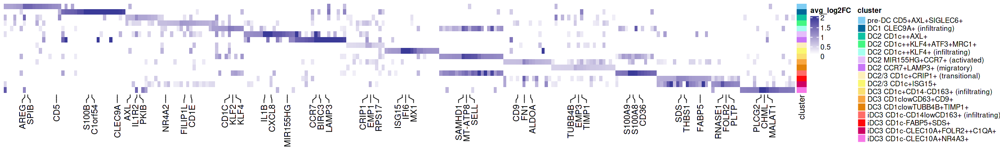

In [98]:
library(ComplexHeatmap)
names(cols)<-levels(dc.only)
options(repr.plot.width=20, repr.plot.height=3)
gene.anno<-columnAnnotation(
    anno = anno_mark(
        which = "column",
        at = genes_to_mark_celltypes$idx,
        side = "right",
        labels = genes_to_mark_celltypes$gene)
    )
clust.anno<-rowAnnotation(show_legend = TRUE,
    cluster = unique(genes_use_df$cluster),
    col = list(cluster=cols)
    )
#ha2<-columnAnnotation(
#     celltypes = anno_block(
#         gp = gpar(fill = col_pal), 
#         labels = genes_use_df$contrast %>% unique

# ))
split<-unique(genes_use_df$cluster)
rownames(.mat)<-NULL
colnames(.mat)<- NULL
t(.mat) %>% 
    Heatmap(
        name = 'avg_log2FC',
        col = circlize::colorRamp2(c(0, 0.1, 2), c('white', 'white', muted('blue'))),
        #column_names_gp = grid::gpar(fontsize = 10),
#         row_dend_side = "right",
        cluster_rows = FALSE,
        cluster_columns = FALSE,
        bottom_annotation = gene.anno, 
       right_annotation = clust.anno)


In [106]:
genes <- c("CD14","FCGR3A","S100A12","ITGAM")

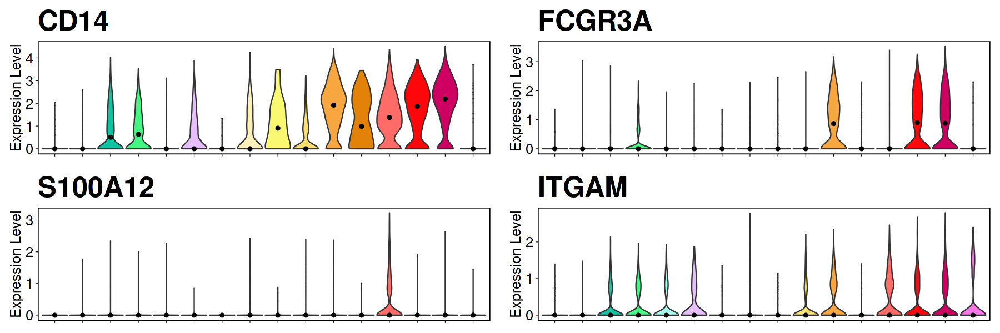

In [107]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

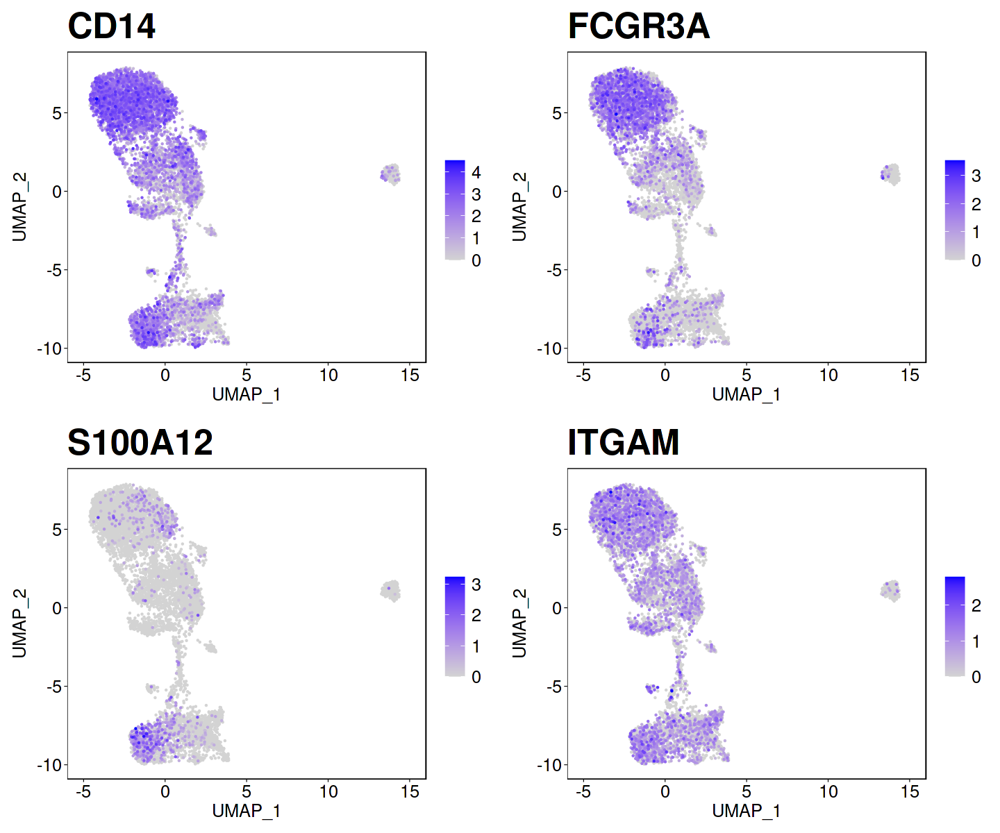

In [108]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

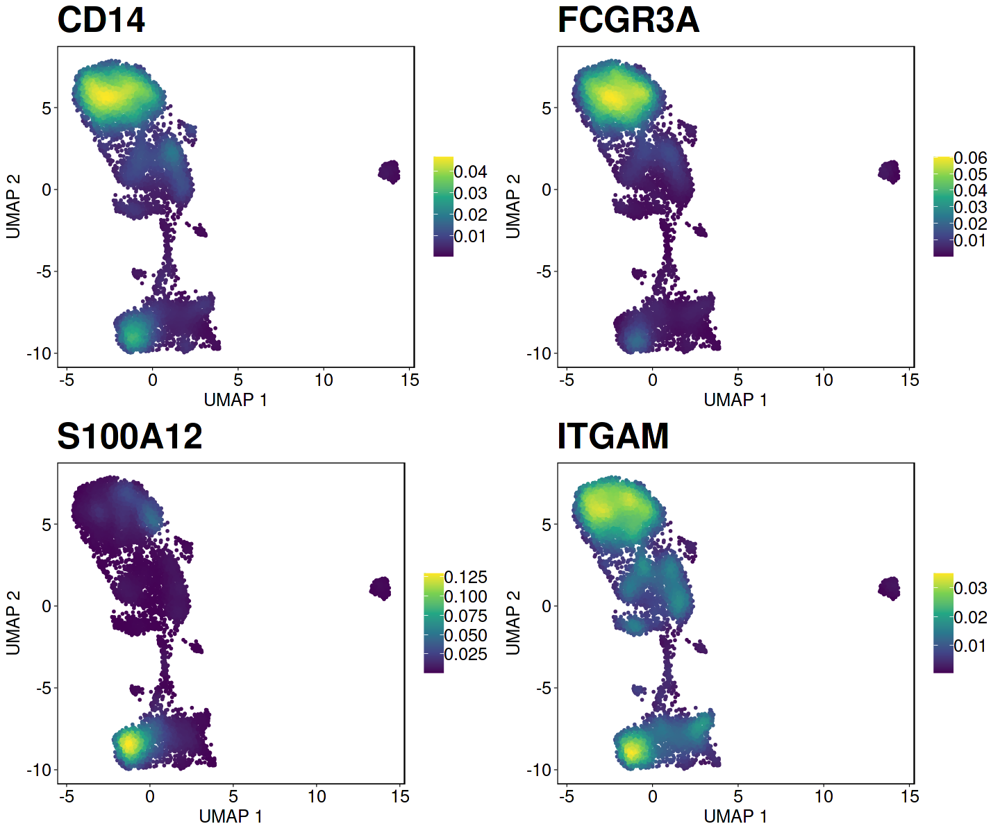

In [109]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0))  }

plot_grid(plotlist=x, ncol=2)


In [110]:
genes <- c("CD1C","FCER1A","CLEC10A","ITGAX")

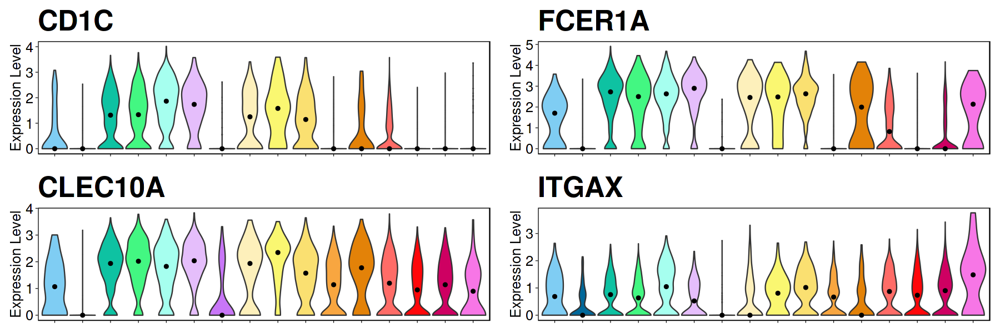

In [111]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

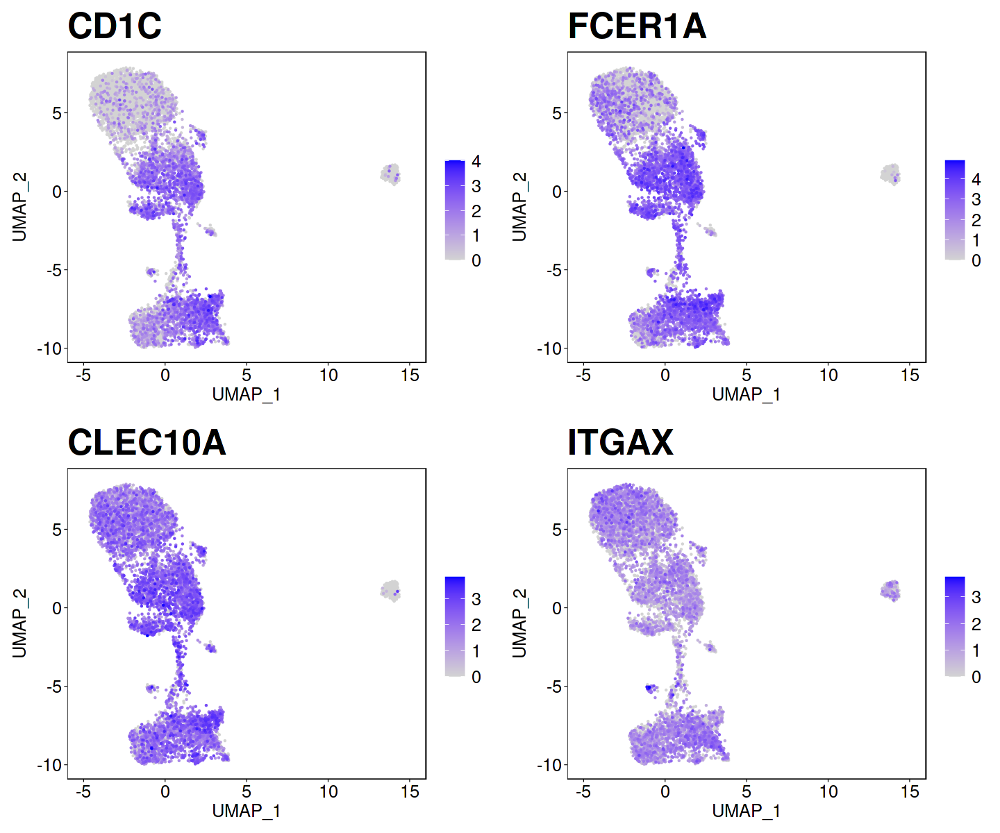

In [112]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

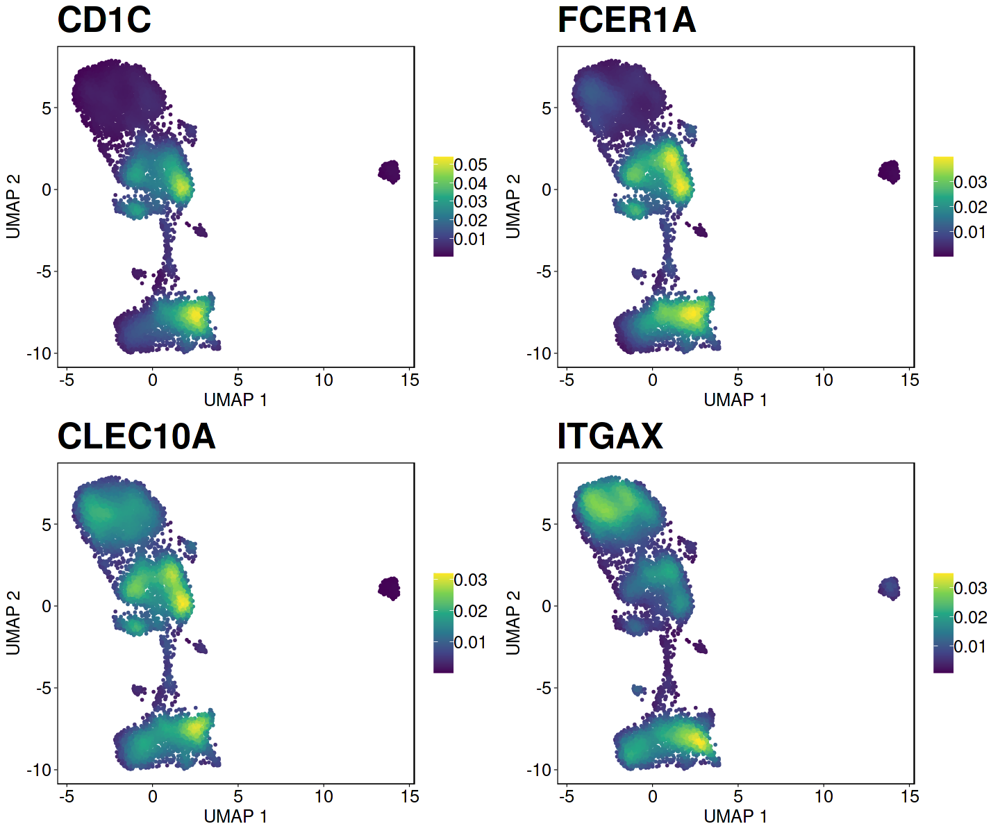

In [113]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0))  }

plot_grid(plotlist=x, ncol=2)


In [114]:
genes <- c("AXL","CXCR4","MRC1","KLF4")

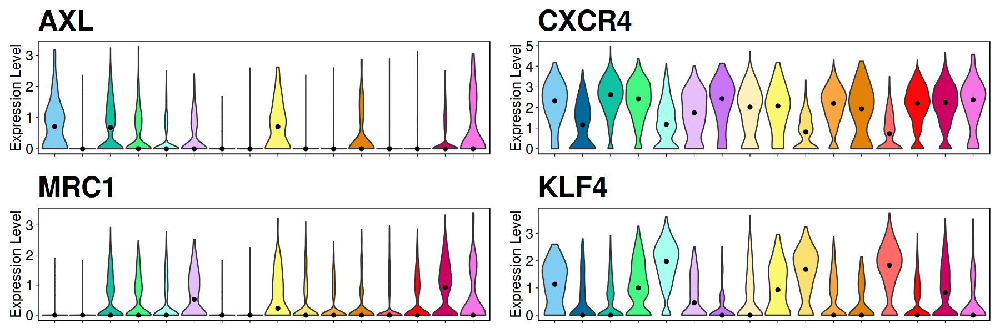

In [115]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

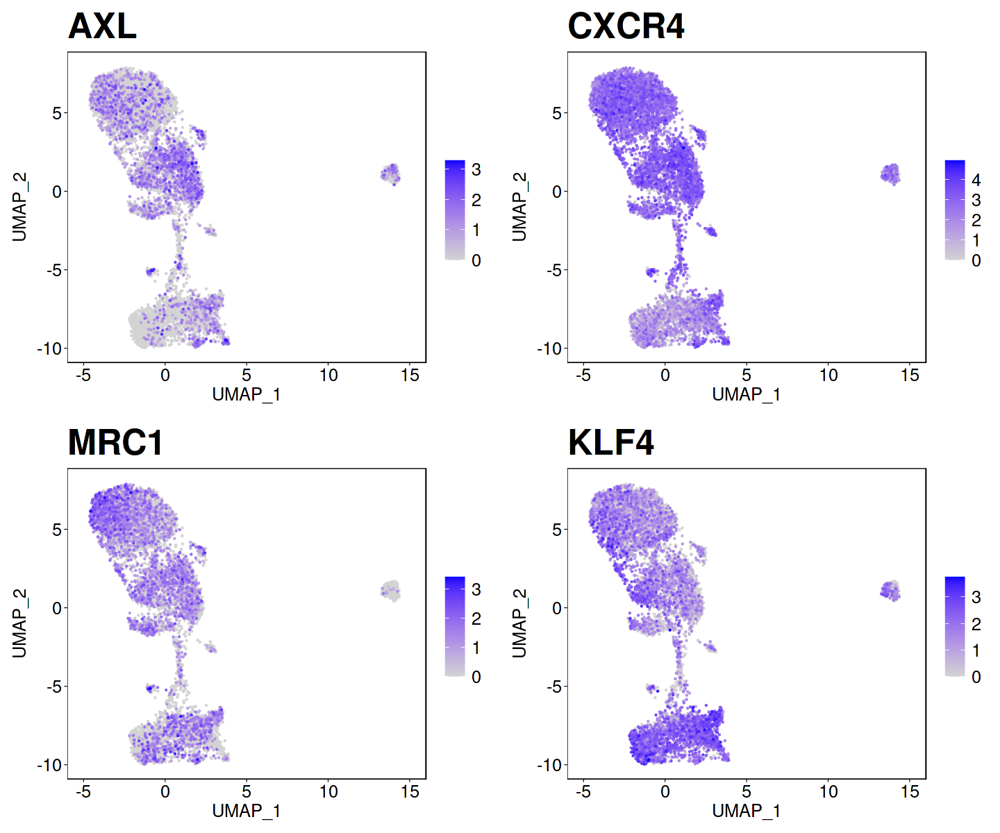

In [116]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

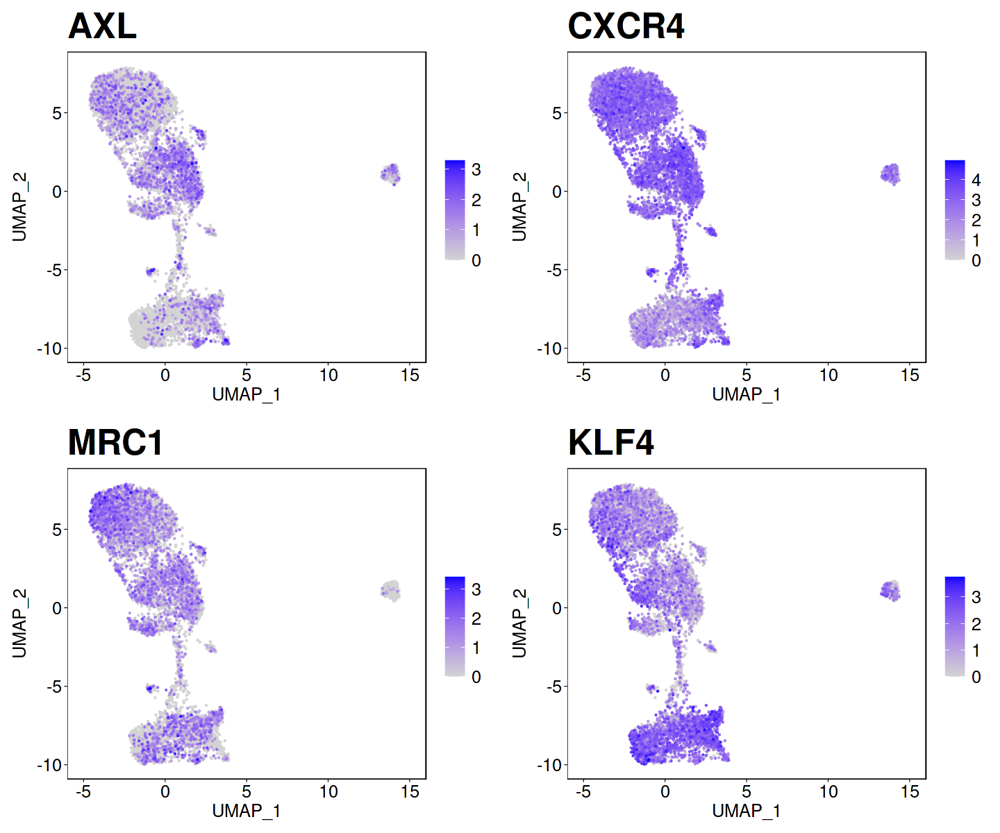

In [116]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

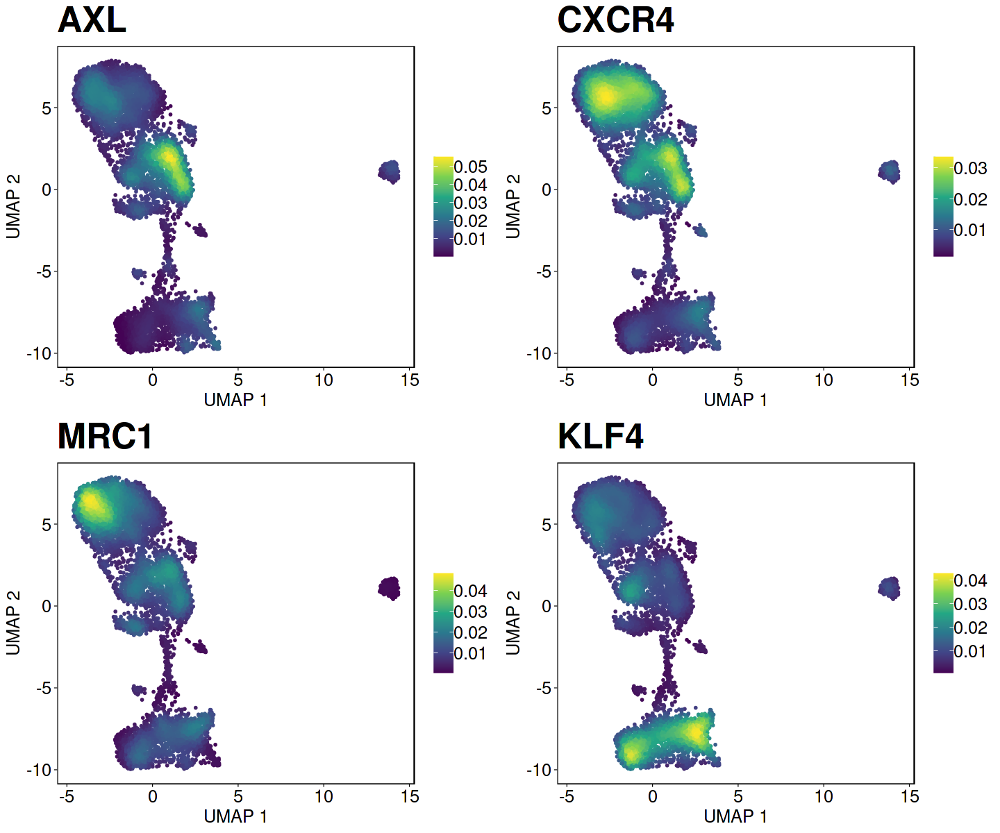

In [117]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0))  }

plot_grid(plotlist=x, ncol=2)


In [118]:
genes <- c("CD163","CD36","CD9","CD63")

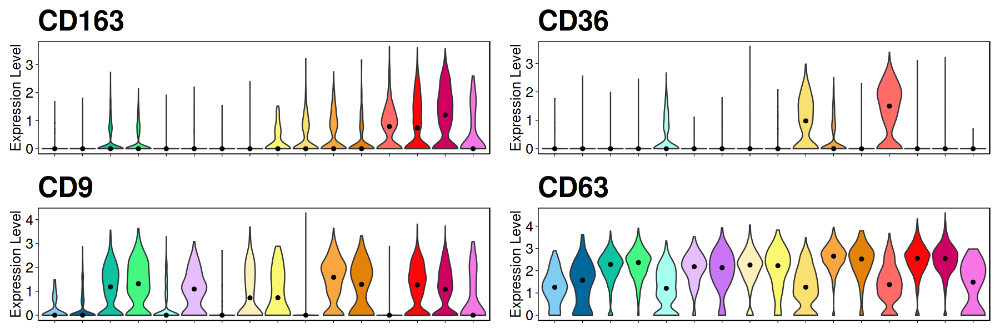

In [119]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

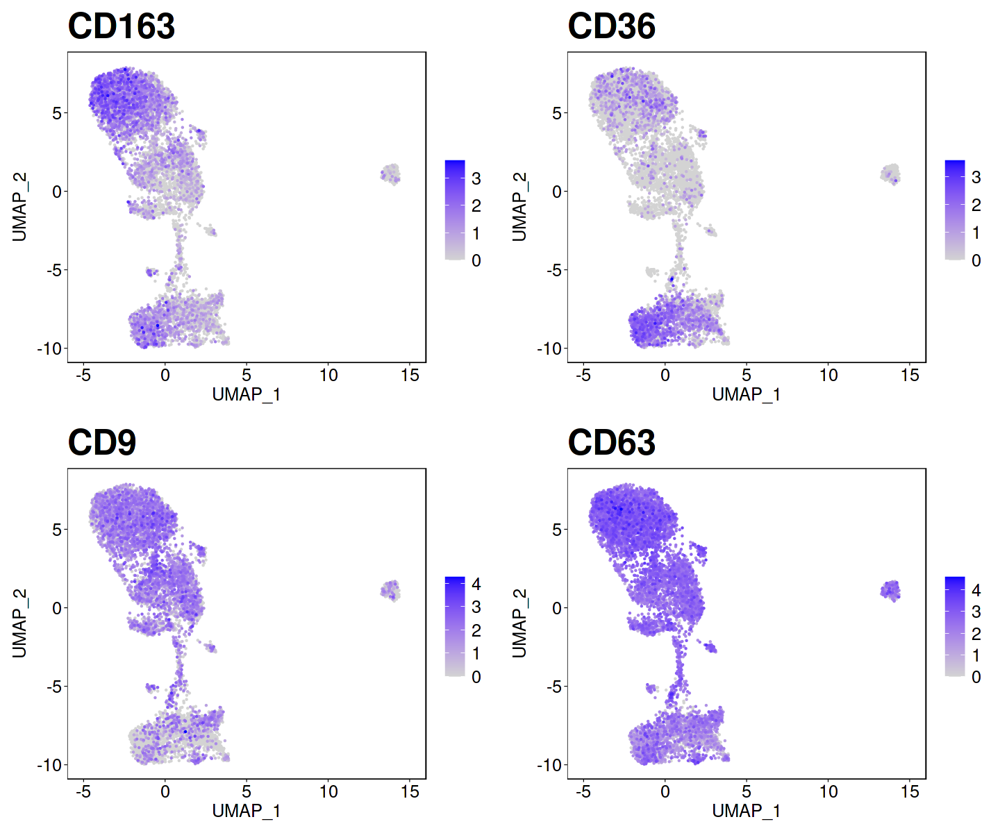

In [120]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

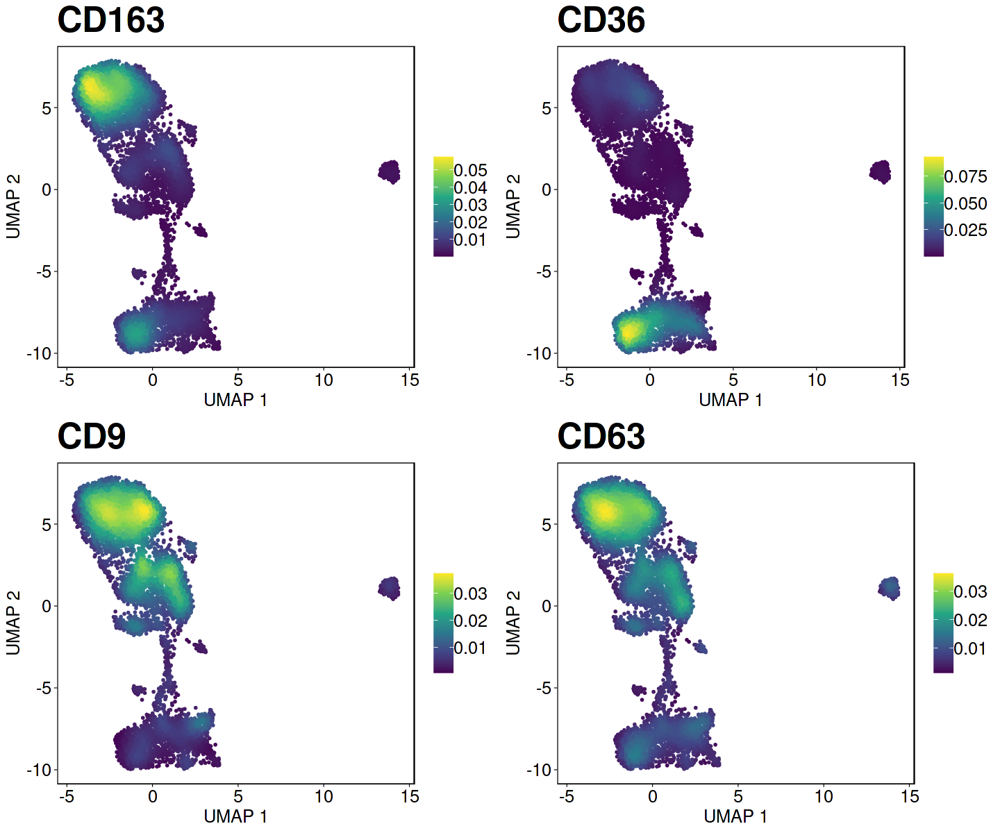

In [121]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0))  }

plot_grid(plotlist=x, ncol=2)


In [246]:
genes <- c("CCR7","MIR155HG","CD40","LAMP3")

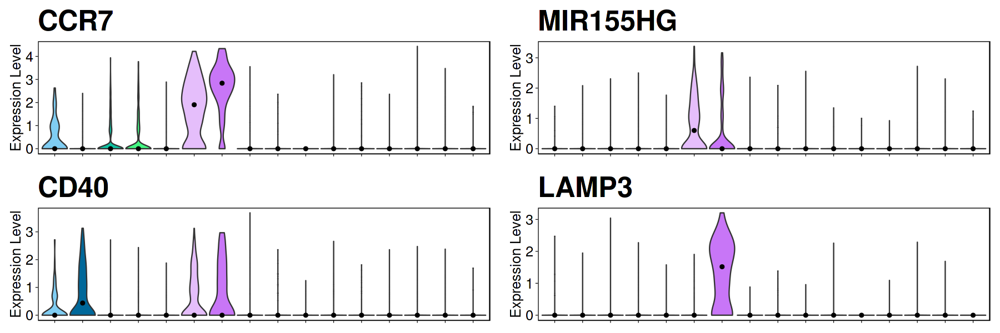

In [247]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- VlnPlot(dc.only, features=gene, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

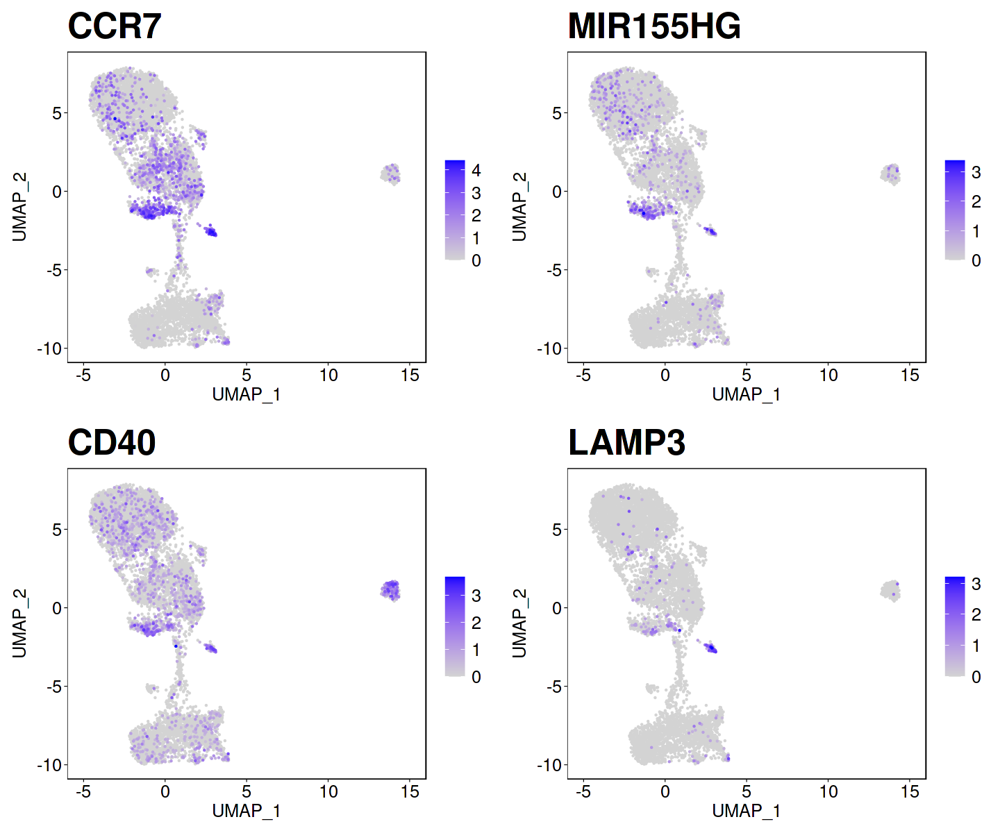

In [248]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- FeaturePlot(dc.only, gene, order = TRUE) + theme_specific + theme(legend.text=element_text(size=15)) }
plot_grid(plotlist=x, ncol=2)

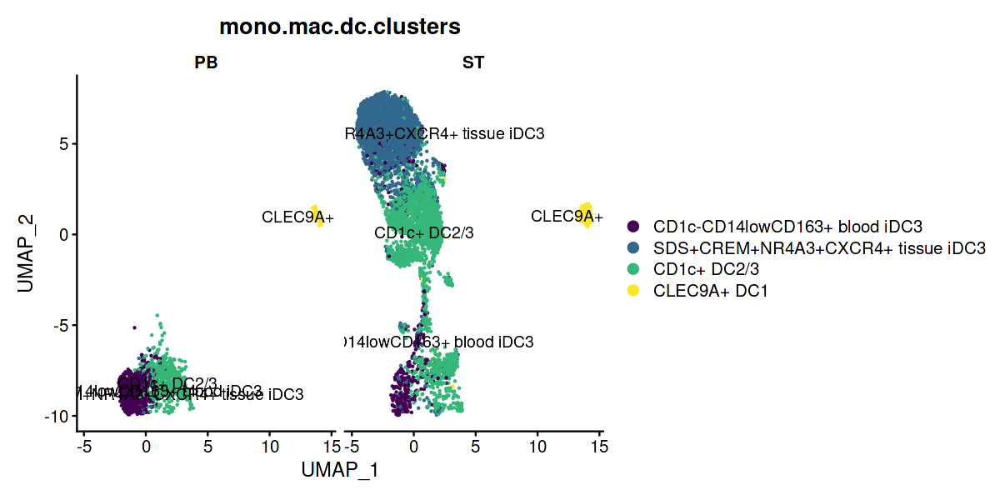

In [127]:
#Previous clustering when with monocytes
options(repr.plot.width=10, repr.plot.height=5)
DimPlot(dc.only, split.by=c("Tissue"), group.by="mono.mac.dc.clusters", label=TRUE)

In [38]:
#Rename your clusters by celltype
dc.only$Tissue <- plyr::revalue(as.character(dc.only$Tissue),
                                        c("PB"='Peripheral Blood (PB)', "ST"='Synovial Tissue (ST)'))

In [39]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(dc.only@meta.data),Embeddings(dc.only, reduction = "umap")[,1], Embeddings(dc.only, reduction = "umap")[,2],
                   dc.only$Tissue,dc.only$condition,dc.only$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=levels(dc.only$clusters)))
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "pre-DC CD5+AXL+SIGLEC6+"               
 [2] "DC1 CLEC9A+ (infiltrating)"            
 [3] "DC2 CD1c++AXL+"                        
 [4] "DC2 CD1c++KLF4+ATF3+MRC1+"             
 [5] "DC2 CD1c++KLF4+ (infiltrating)"        
 [6] "DC2 MIR155HG+CCR7+ (activated)"        
 [7] "DC2 CCR7+LAMP3+ (migratory)"           
 [8] "DC2/3 CD1c+CRIP1+ (transitional)"      
 [9] "DC2/3 CD1c+ISG15+"                     
[10] "DC3 CD1c+CD14-CD163+ (infiltrating)"   
[11] "DC3 CD1clowCD63+CD9+"                  
[12] "DC3 CD1clowTUBB4B+TIMP1+"              
[13] "iDC3 CD1c-CD14lowCD163+ (infiltrating)"
[14] "iDC3 CD1c-FABP5+SDS+"                  
[15] "iDC3 CD1c-CLEC10A+FOLR2++C1QA+"        
[16] "iDC3 CD1c-CLEC10A+NR4A3+"

In [11]:
theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

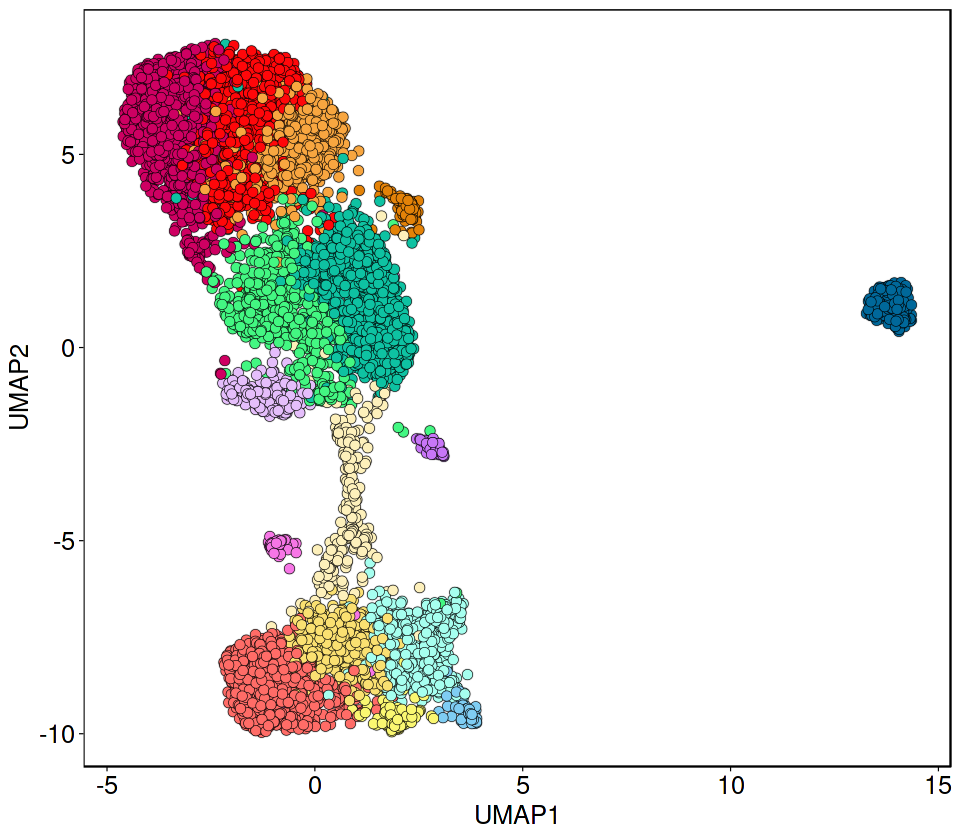

In [44]:
options(repr.plot.width=8, repr.plot.height=7)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=2.5, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=2.5, shape=21, stroke = 1/5) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

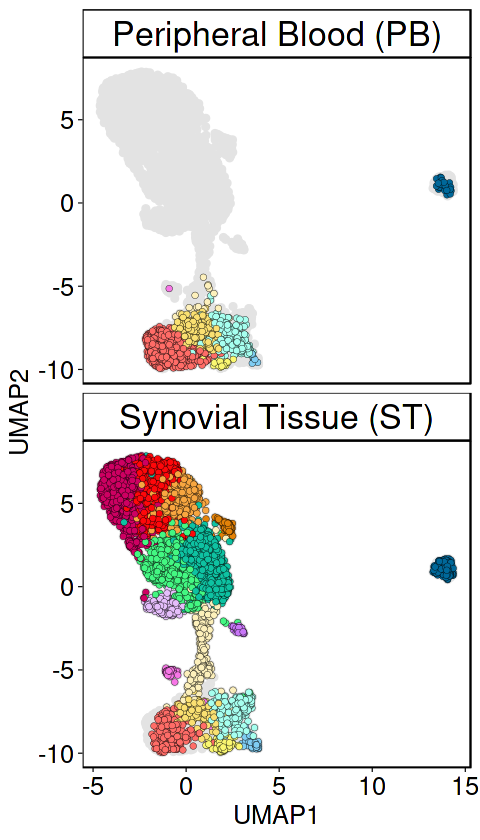

In [43]:
options(repr.plot.width=4, repr.plot.height=7)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=1.5, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=1.5, shape=21, stroke = 1/8) + facet_wrap(~facet_col, ncol=1) +
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) + theme_specific + guides(fill=FALSE) 

In [53]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(dc.only@meta.data),Embeddings(dc.only, reduction = "umap")[,1], Embeddings(dc.only, reduction = "umap")[,2],
                   dc.only$Tissue,dc.only$condition,dc.only$mono.mac.dc.clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "facet_col", "Group", "color_col")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")
umap$color_col <- as.ordered(factor(umap$color_col, levels=c('SDS+CREM+NR4A3+CXCR4+ tissue iDC3','CD1c+ DC2/3','CD1c-CD14lowCD163+ blood iDC3','CLEC9A+ DC1'))
                    )
levels(umap$color_col)
umap <- umap[order(umap$ID),]

[1] "SDS+CREM+NR4A3+CXCR4+ tissue iDC3" "CD1c+ DC2/3"                      
[3] "CD1c-CD14lowCD163+ blood iDC3"     "CLEC9A+ DC1"

In [54]:
mono.dc.cols <- c("yellow", 
      "#B4FF00","#68B731","#00689A")

In [57]:

theme_specific <- theme_linedraw() + theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank()) + theme(plot.title=element_text(size=30, face="bold"), axis.text=element_text(size=15), axis.title=element_text(size=15)) + theme(strip.background = element_rect(colour = "black", fill = "white"),strip.text = element_text(size = 20, color="black"))

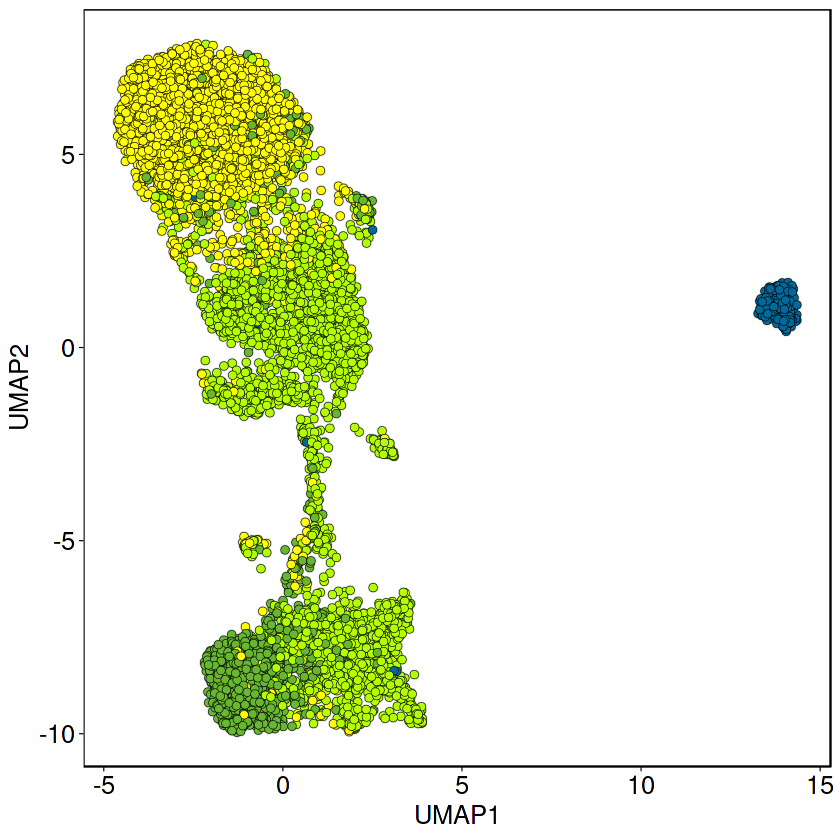

In [58]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=2, shape=21) +
  geom_point(aes(fill=factor(color_col)),color="black", size=2, shape=21, stroke = 1/5) + 
  scale_fill_manual(name=NULL, labels = levels(umap$color_col), guide="legend", values=mono.dc.cols) + theme_specific + guides(fill=FALSE) 

## Cluster distributions per conditon

In [64]:
table(dc.only$seurat_clusters, dc.only$Tissue)

    
      PB  ST
  0    0 986
  1    0 794
  2  559 196
  3  379 323
  4    0 701
  5    0 587
  6    0 526
  7    0 493
  8  344 127
  9    0 291
  10  19 244
  11   0 247
  12  28 216
  13   0 202
  14   0 191
  15   0 103
  16   0  87
  17  20  66
  18   9  68
  19   1  62

In [65]:
dc.only.st <- subset(dc.only, subset=Tissue=="ST")

In [66]:
Idents(dc.only.st) <- "condition"

In [67]:
table(dc.only.st$condition)


     PB_Healthy    PB_Active RA      ST_Healthy    ST_Active RA ST_Remission RA 
              0               0            1373            4105            1032 

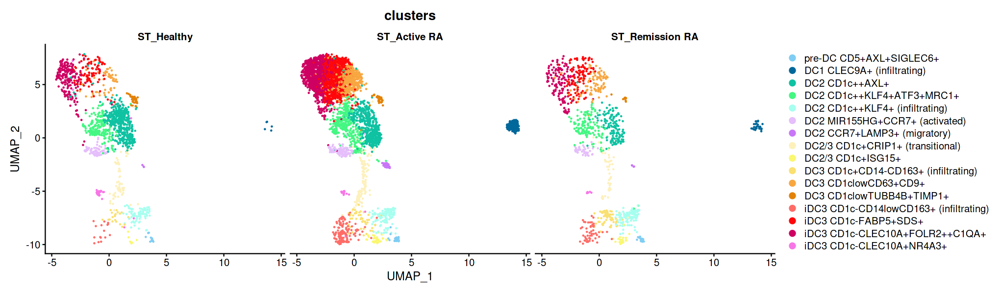

In [68]:
#Not normalized cell number per condition
options(repr.plot.width=17, repr.plot.height=5)
DimPlot(dc.only.st, split.by=c("condition"), group.by="clusters", cols=cols)

In [69]:
#Create data frame for information required to plot 
umap <- data.frame(rownames(dc.only.st@meta.data),Embeddings(dc.only.st, reduction = "umap")[,1], Embeddings(dc.only.st, reduction = "umap")[,2],
                   dc.only.st$Tissue,dc.only.st$condition,dc.only.st$clusters)
colnames(umap) <- c("ID","UMAP1", "UMAP2", "Tissue", "Group", "Cluster")

#Save
write.csv(umap, "single.cell-umap.plot.csv")

allcells <-  as.data.frame(cbind(umap$UMAP1,umap$UMAP2))
colnames(allcells) <- c("UMAP1", "UMAP2")

In [70]:
umap$Cluster <- as.ordered(factor(umap$Cluster, levels=levels(dc.only$clusters)))

In [71]:
umap <- umap[order(umap$Cluster),]

In [72]:
umap

,ID,UMAP1,UMAP2,Tissue,Group,Cluster
,<chr>,<dbl>,<dbl>,<chr>,<fct>,<ord>
GCAAACTAGCCAACAG-1_1_1,GCAAACTAGCCAACAG-1_1_1,3.195277,-9.286955,ST,ST_Healthy,pre-DC CD5+AXL+SIGLEC6+
GGCAATTAGCTAGCCC-1_5_5,GGCAATTAGCTAGCCC-1_5_5,3.835068,-9.599429,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
TGCTGCTCATGGTCAT-1_5_5,TGCTGCTCATGGTCAT-1_5_5,3.769115,-9.639492,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
ACTTGTTAGCTGAACG-1_6_6,ACTTGTTAGCTGAACG-1_6_6,3.701072,-9.515464,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
CTCTAATTCCTCGCAT-1_6_6,CTCTAATTCCTCGCAT-1_6_6,3.607049,-9.654614,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
TGAGGGACAGTACACT-1_10_10,TGAGGGACAGTACACT-1_10_10,3.707508,-9.442734,ST,ST_Remission RA,pre-DC CD5+AXL+SIGLEC6+
CGGAGCTCAGTCCTTC-1_11_11,CGGAGCTCAGTCCTTC-1_11_11,2.982561,-9.430304,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
GACTACAGTCTTGTCC-1_11_11,GACTACAGTCTTGTCC-1_11_11,3.710388,-9.450400,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+
GCAATCATCCTTAATC-1_11_11,GCAATCATCCTTAATC-1_11_11,3.725126,-9.562121,ST,ST_Active RA,pre-DC CD5+AXL+SIGLEC6+


In [73]:
#Set seed for reproducibility
set.seed(89)
#Downsample for equal comparison between conditions
numcells <- min(sapply(c(as.character(unique(umap$Group))), function(x) length(rownames(umap[umap$Group==x,]))))
downsampled <-  as.vector(sapply(c(as.character(unique(umap$Group))), function(x) sample(rownames(umap[umap$Group==x,]), 
                                                                                         size=numcells, replace=F, prob=NULL )))
labels <- levels(umap$Cluster)
              

In [74]:
downsampledumap <- umap[downsampled,]
downsampledumap <- downsampledumap[order(downsampledumap$Cluster),]

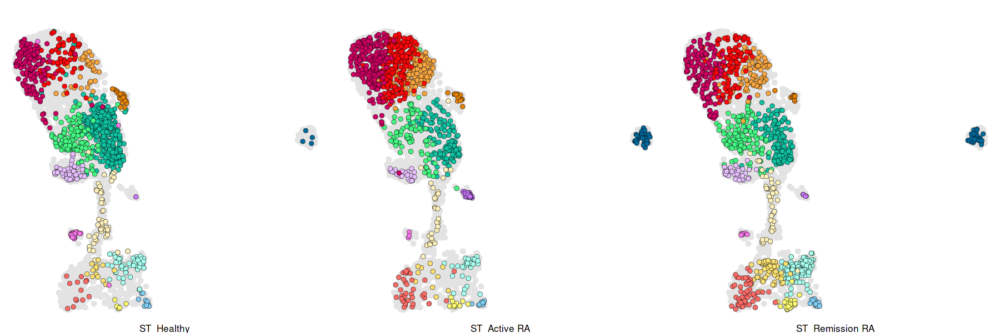

In [75]:
options(repr.plot.width=15, repr.plot.height=5)
ggplot(umap, aes(x=UMAP1, y=UMAP2)) + 
  geom_point(data=allcells, colour="grey89", fill="grey89", size=2, shape=21) +
  geom_point(data=downsampledumap, aes(fill=factor(Cluster)),color="black", size=2, shape=21, stroke = 1/6) + facet_grid(~Group, switch="x") + 
  scale_fill_manual(name=NULL, labels = labels, guide="legend", values=cols) + theme_void() + ggtitle("") + guides(fill=FALSE) + theme(strip.text=element_text(size=10))

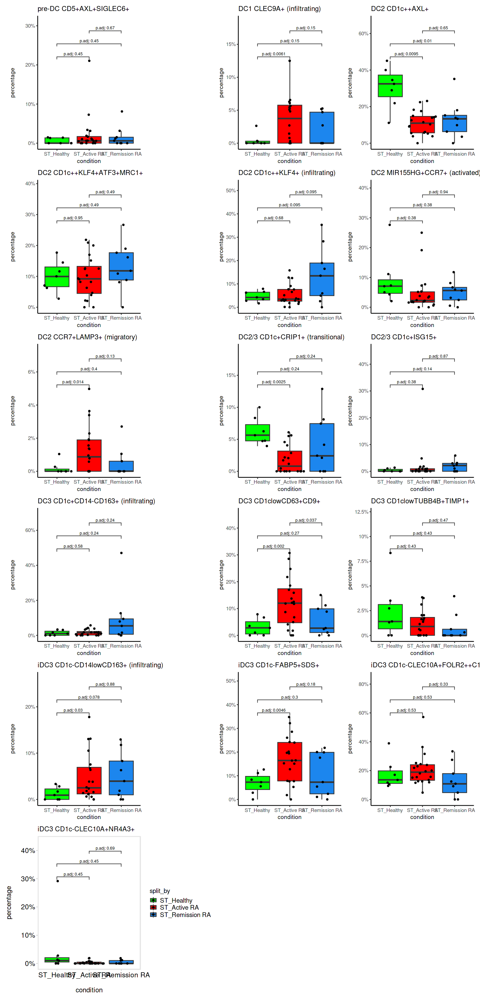

In [76]:
library(pochi)
options(repr.plot.width=12, repr.plot.height=25)
AbundancePlot(dc.only.st, group.by = "clusters", split.by = "condition", 
              replicate.by = "Unique_ID", perform.stat.test=TRUE,
              fill_colors=c("green", "red", "dodgerblue2")) + theme_powerpoint()

In [77]:
Idents(dc.only.st) <- "clusters"

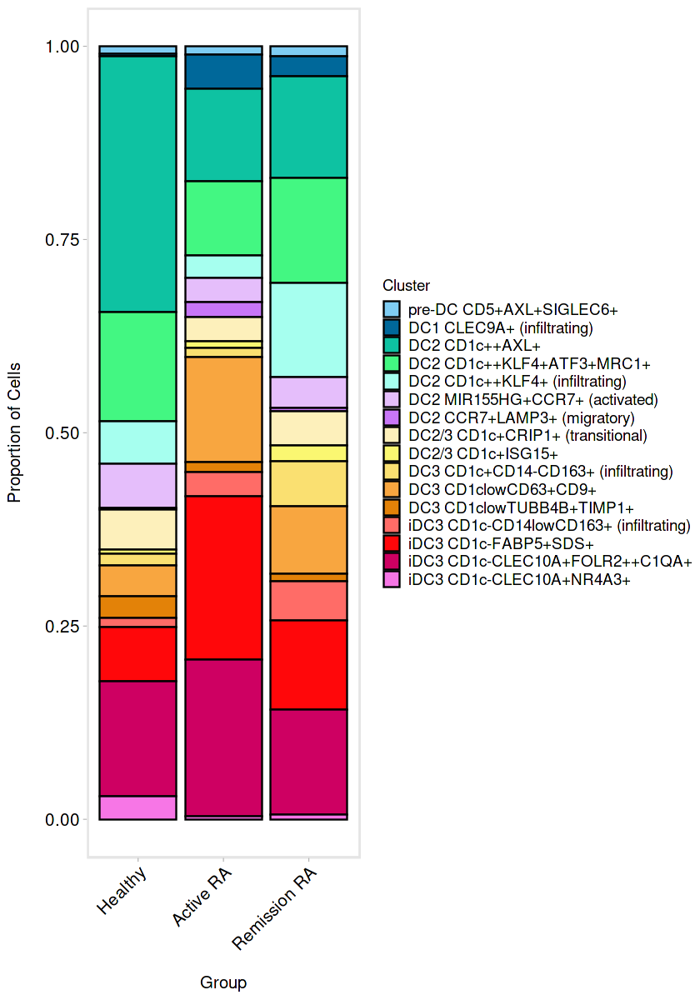

In [78]:
#Synovial Tissue only
freq_table_type <- as.data.frame(prop.table(x = table(Idents(dc.only.st), dc.only.st$group), margin = 2))
freq_table_type$Var2 <- as.ordered(factor(freq_table_type$Var2, c("Healthy","Active RA","Remission RA")))
options(repr.plot.width=7, repr.plot.height=10)
ggplot(data=freq_table_type, aes(x=freq_table_type$Var2, y=freq_table_type$Freq, fill=freq_table_type$Var1)) + theme_powerpoint() +
  geom_bar(stat="identity", color="black") + labs(x="Group", y="Proportion of Cells", fill="Cluster") +scale_fill_manual(values=cols)+ theme(axis.text.x=element_text(angle=45, hjust=1))

In [79]:
table(dc.only$Unique_ID)


             A1         A10-RNA         A2_HTO2              A3         A5_HTO3 
             61              95              76              55             345 
        A5_HTO5         A7_HTO4         A7_HTO5              A8          A9-RNA 
            741              19              96              53              85 
         HC0547          HC0572          HC0701          HC0732      NaiveSA131 
             71             293              36              60              46 
     NaiveSA138      NaiveSA146      NaiveSA172     O1_PB_HD1_A     O1_PB_HD2_C 
             49             321             416             225              77 
   O1_PB_HD3_ML    O1_PB_HD4_MS     O3_PB_HD1_A     O3_PB_HD2_C    O3_PB_HD3_ML 
            100             143             183              47             161 
   O3_PB_HD4_MS        PBMC_10X        RemSA132        RemSA160        RemSA161 
            113              92             193              15             101 
       RemSA174  ResistantS

In [80]:
dc.only.st$condition.sample <- paste0(dc.only.st$group,".",dc.only.st$Unique_ID)

In [81]:
freq_table_sample <- as.data.frame(prop.table(x = table(dc.only.st$clusters, dc.only.st@meta.data[, "condition.sample"]), margin = 2))

In [82]:
colnames(freq_table_sample) <- c("Cluster","Sample","Freq")

In [83]:
head(freq_table_sample)

,Cluster,Sample,Freq
,<fct>,<fct>,<dbl>
1,pre-DC CD5+AXL+SIGLEC6+,Active RA.A1,0.01639344
2,DC1 CLEC9A+ (infiltrating),Active RA.A1,0.06557377
3,DC2 CD1c++AXL+,Active RA.A1,0.11475410
4,DC2 CD1c++KLF4+ATF3+MRC1+,Active RA.A1,0.08196721
5,DC2 CD1c++KLF4+ (infiltrating),Active RA.A1,0.06557377
6,DC2 MIR155HG+CCR7+ (activated),Active RA.A1,0.03278689


In [158]:
write.csv(table(dc.only.st$condition.sample),"dc.only.st_total_cells_per_sample.csv")

In [159]:
write.csv(reshape(freq_table_sample, timevar="Sample",idvar="Cluster", direction="wide"),"dc.only.st_prop_table_sample.mergediDC3.csv")

## Protein expression

In [3]:
glasgow3 <- subset(dc.only, subset=Experiment=="Glasgow3")
glasgow3

An object of class Seurat 
19143 features across 1626 samples within 1 assay 
Active assay: RNA (19143 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, harmony

In [4]:
glasgow3orig <- readRDS("/datastore/MKS_Data/UNpublished/DC_paper_Immunity/Immunity_Oxford+Glasgow1-3.rds")
glasgow3orig <- subset(glasgow3orig, subset=Experiment=="Glasgow3")
glasgow3orig <- subset(glasgow3orig, cells = Cells(glasgow3))

In [5]:
glasgow3[["ADT"]] <- CreateAssayObject(data=glasgow3orig@assays$ADT@data)

In [6]:
rownames(glasgow3@assays$ADT)

[1] "Hu.CD86"            "Hu.CD274"           "Hu.CD270"          
  [4] "Hu.CD155"           "Hu.CD112"           "Hu.CD47"           
  [7] "Hu.CD48"            "Hu.CD40"            "Hu.CD154"          
 [10] "Hu.CD52"            "Hu.CD3-UCHT1"       "Hu.CD8"            
 [13] "Hu.CD56"            "Hu.CD19"            "Hu.CD33"           
 [16] "Hu.CD11c"           "Hu.HLA.ABC"         "Hu.CD45RA"         
 [19] "Hu.CD123"           "Hu.CD7"             "HuMs.CD49f"        
 [22] "Hu.CD194"           "Hu.CD4-RPA.T4"      "HuMs.CD44"         
 [25] "Hu.CD14-M5E2"       "Hu.CD16"            "Hu.CD25"           
 [28] "Hu.CD45RO"          "Hu.CD279"           "Hu.TIGIT"          
 [31] "Isotype-MOPC.21"    "Isotype-MOPC.173"   "Isotype-MPC.11"    
 [34] "Isotype-RTK4530"    "Hu.CD20-2H7"        "Hu.CD335"          
 [37] "Hu.CD31"            "Hu.Podoplanin"      "Hu.CD146"          
 [40] "Hu.IgM"             "Hu.CD5"             "Hu.CD183"          
 [43] "Hu.CD195"           "Hu.CD32"            "Hu.CD196"          
 [46] "Hu.CD185"           "Hu.CD103"           "Hu.CD69"           
 [49] "Hu.CD62L"           "Hu.CD161"           "Hu.CD152"          
 [52] "Hu.CD223"           "Hu.KLRG1"           "Hu.CD27"           
 [55] "Hu.CD107a"          "Hu.CD95"            "Hu.CD134"          
 [58] "Hu.HLA.DR"          "Hu.CD1c"            "Hu.CD11b"          
 [61] "Hu.CD64"            "Hu.CD141"           "Hu.CD314"          
 [64] "Hu.CD35"            "Hu.CD57"            "Hu.CD272"          
 [67] "HuMsRt.CD278"       "Hu.CD275-B7.RP1"    "Hu.CD58"           
 [70] "Hu.CD39"            "Hu.CX3CR1"          "Hu.CD24"           
 [73] "Hu.CD21"            "Hu.CD11a"           "Hu.CD79b"          
 [76] "Hu.CD244"           "Hu.CD169"           "HuMs.integrin.b7"  
 [79] "Hu.CD268"           "Hu.CD42b"           "Hu.CD54"           
 [82] "Hu.CD62P"           "Hu.CD119"           "Hu.TCR.AB"         
 [85] "Isotype-RTK2071"    "Isotype-G0114F7"    "Isotype-RTK2758"   
 [88] "Isotype-RTK4174"    "Isotype-HTK888"     "Hu.CD192"          
 [91] "Hu.CD122"           "Hu.CD267"           "Hu.FceRIa"         
 [94] "Hu.CD41"            "Hu.CD137"           "Hu.CD43"           
 [97] "Hu.CD163"           "Hu.CD83"            "Hu.CD13"           
[100] "Hu.CD2"             "Hu.CD226-11A8"      "Hu.CD29"           
[103] "Hu.CD303"           "Hu.CD49b"           "Hu.CD61"           
[106] "Hu.CD81"            "Hu.CD55"            "Hu.IgD"            
[109] "Hu.CD18"            "Hu.CD28"            "Hu.CD38-HIT2"      
[112] "Hu.CD127"           "Hu.CD45-HI30"       "Hu.CD22"           
[115] "Hu.CD71"            "Hu.CD26"            "Hu.CD115"          
[118] "Hu.CD63"            "Hu.CD304"           "Hu.CD36"           
[121] "Hu.CD172a"          "Hu.CD72"            "Hu.CD158"          
[124] "Hu.CD93"            "Hu.CD200"           "Hu.CD49a"          
[127] "Hu.CD49d"           "Hu.CD73"            "Hu.CD9"            
[130] "Hu.TCR.Va7.2"       "Hu.TCR.Vd2"         "Hu.CD354"          
[133] "Hu.CD305-LAIR1"     "Hu.LOX.1"           "Hu.CD158e1"        
[136] "Hu.CD109"           "Hu.CD142"           "Hu.CD319"          
[139] "Hu.CD99"            "Hu.CLEC12A"         "Hu.CD151"          
[142] "Hu.CD352"           "Hu.CLEC1B"          "Hu.CD94"           
[145] "Hu.IgE"             "Hu.CD150"           "Hu.CD162"          
[148] "Hu.CD84"            "Hu.Ig.LightChain.k" "Hu.CD85j"          
[151] "Hu.CD23"            "Hu.Ig.LightChain.l" "Hu.CD328"          
[154] "Hu.GPR56"           "Hu.CD82"            "Hu.NKp80"          
[157] "Hu.CD131"           "Hu.CD74"            "Hu.CD116"          
[160] "Hu.CD37"            "Hu.CD101"           "Hu.HLA.DR.DP.DQ"   
[163] "Hu.CD88"

In [129]:
Idents(glasgow3) <- "dc.type"

In [131]:
unique(Idents(glasgow3))

[1] iDC3   DC2    DC3    pre-DC DC1   
Levels: iDC3 DC2 DC3 pre-DC DC1

In [ ]:
DefaultAssay(glasgow3) <- "ADT"

In [ ]:
DC3vsiDC3 <- FindMarkers(glasgow3, ident.1=c('DC3'), ident.2=c("iDC3"), test.use="MAST")

In [ ]:
DC3vsiDC3 %>% arrange(avg_logFC2)

In [96]:
proteins <- c("Hu.CD14-M5E2","Hu.CD16",
              "Hu.CD11b","Hu.CD64")

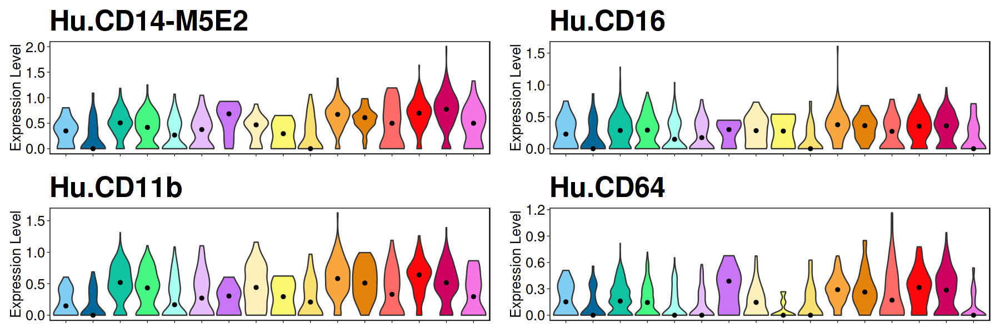

In [97]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3) <- "ADT"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

In [10]:
proteins <- c("Hu.CD1c","Hu.CD9",
              "Hu.CD11b","Hu.CD64")

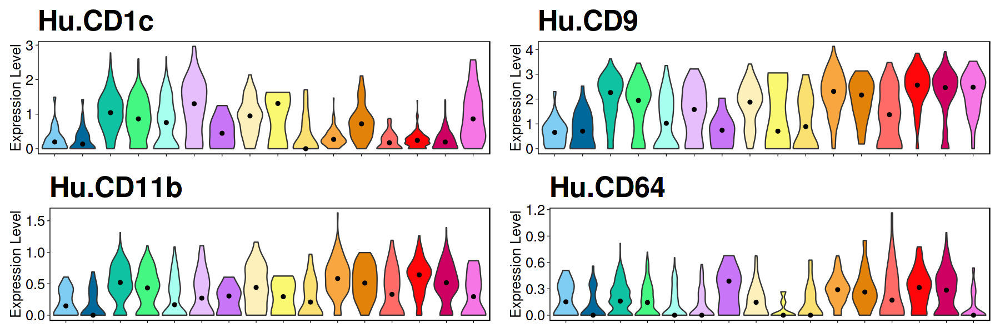

In [13]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3) <- "ADT"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

In [25]:
proteins <- c("CLEC10A","CD14")

In [35]:
Idents(glasgow3) <- "group"
unique(Idents(glasgow3))

[1] Active RA    Remission RA Healthy     
Levels: Active RA Remission RA Healthy

In [36]:
glasgow3.activeRA <- subset(glasgow3, idents="Active RA")
Idents(glasgow3.activeRA) <- "clusters"
glasgow3.remRA <- subset(glasgow3, idents="Remission RA")
Idents(glasgow3) <- "clusters"
Idents(glasgow3.remRA) <- "clusters"

In [42]:
names(cols) <- levels(Idents(dc.only))

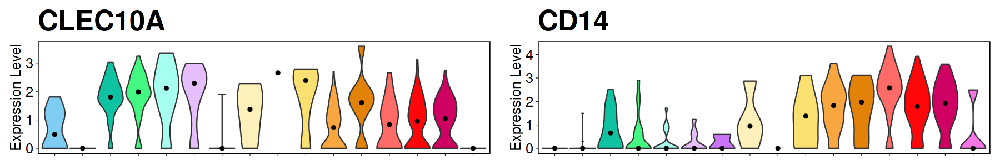

In [43]:
options(repr.plot.width=15, repr.plot.height=2.5)
x <- list()
DefaultAssay(glasgow3) <- "RNA"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3.activeRA, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

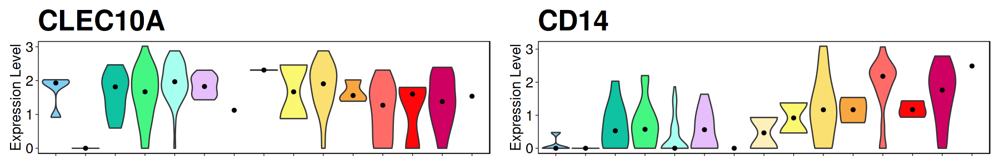

In [44]:
options(repr.plot.width=15, repr.plot.height=2.5)
x <- list()
DefaultAssay(glasgow3) <- "RNA"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3.remRA, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

In [45]:
Idents(glasgow3) <- "clusters"
unique(Idents(glasgow3))

[1] iDC3 CD1c-CD14lowCD163+ (infiltrating)
 [2] DC2 CD1c++AXL+                        
 [3] iDC3 CD1c-CLEC10A+FOLR2++C1QA+        
 [4] DC2 CD1c++KLF4+ (infiltrating)        
 [5] iDC3 CD1c-FABP5+SDS+                  
 [6] DC3 CD1clowTUBB4B+TIMP1+              
 [7] pre-DC CD5+AXL+SIGLEC6+               
 [8] DC2 CD1c++KLF4+ATF3+MRC1+             
 [9] DC1 CLEC9A+ (infiltrating)            
[10] DC3 CD1clowCD63+CD9+                  
[11] DC3 CD1c+CD14-CD163+ (infiltrating)   
[12] DC2 MIR155HG+CCR7+ (activated)        
[13] DC2 CCR7+LAMP3+ (migratory)           
[14] DC2/3 CD1c+ISG15+                     
[15] DC2/3 CD1c+CRIP1+ (transitional)      
[16] iDC3 CD1c-CLEC10A+NR4A3+              
16 Levels: pre-DC CD5+AXL+SIGLEC6+ ... iDC3 CD1c-CLEC10A+NR4A3+

In [46]:
glasgow3.DC3inf <- subset(glasgow3, idents="DC3 CD1c+CD14-CD163+ (infiltrating)")
glasgow3.DC3 <- subset(glasgow3, idents="DC3 CD1clowCD63+CD9+")
glasgow3.iDC3inf <- subset(glasgow3, idents="iDC3 CD1c-CD14lowCD163+ (infiltrating)")
glasgow3.iDC3 <- subset(glasgow3, idents="iDC3 CD1c-FABP5+SDS+")

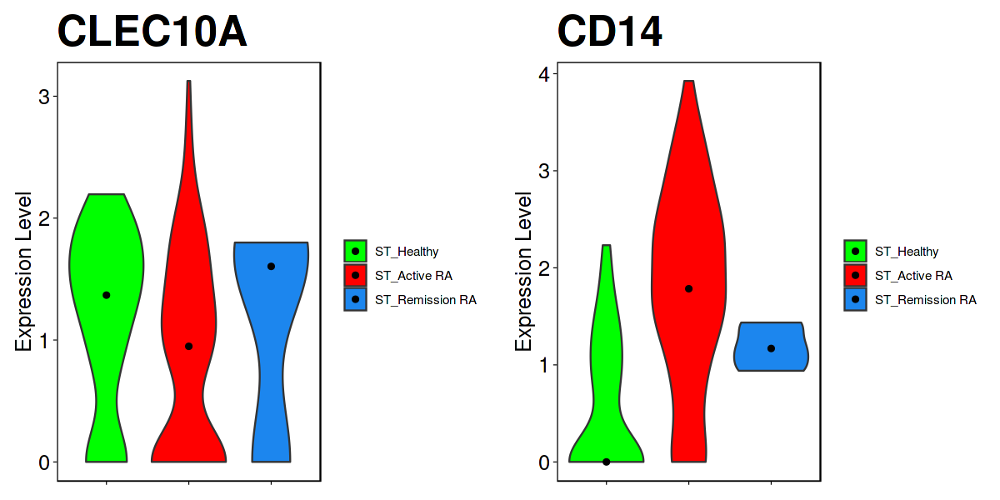

In [57]:
options(repr.plot.width=10, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3.iDC3) <- "RNA"
Idents(glasgow3.iDC3) <- "condition"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3.iDC3, features=protein, pt.size=0,ncol=1, cols=c("green","red","dodgerblue2")) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) 
}
plot_grid(plotlist=x, ncol=2)

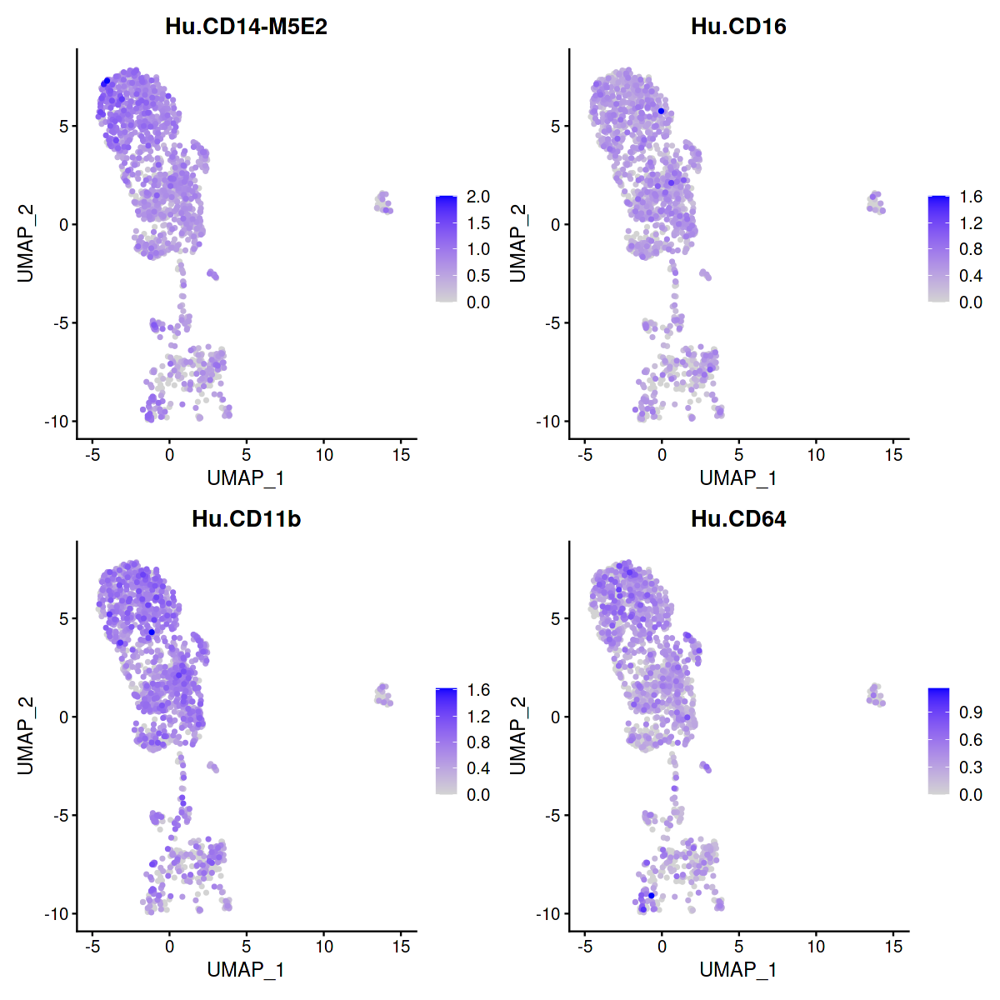

In [98]:
options(repr.plot.width=10, repr.plot.height=10)
FeaturePlot(glasgow3, proteins, order = TRUE)

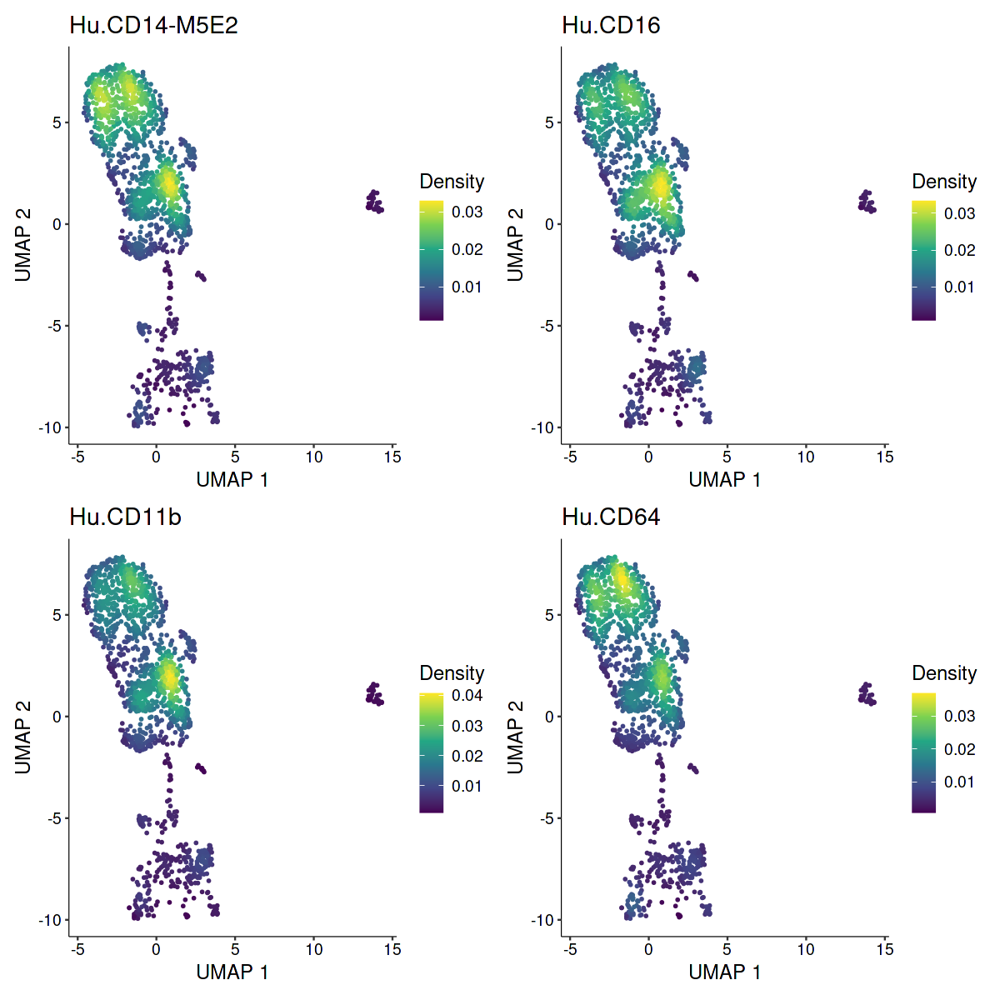

In [99]:
options(repr.plot.width=10, repr.plot.height=10)
plot_density(glasgow3, proteins, reduction="umap")

In [100]:
proteins <- c("Hu.CD1c","Hu.CD11c",
              "Hu.FceRIa","Hu.CD5")

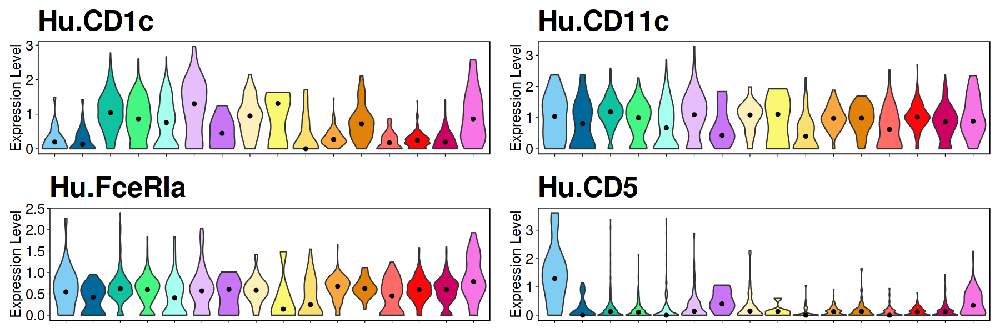

In [101]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3) <- "ADT"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

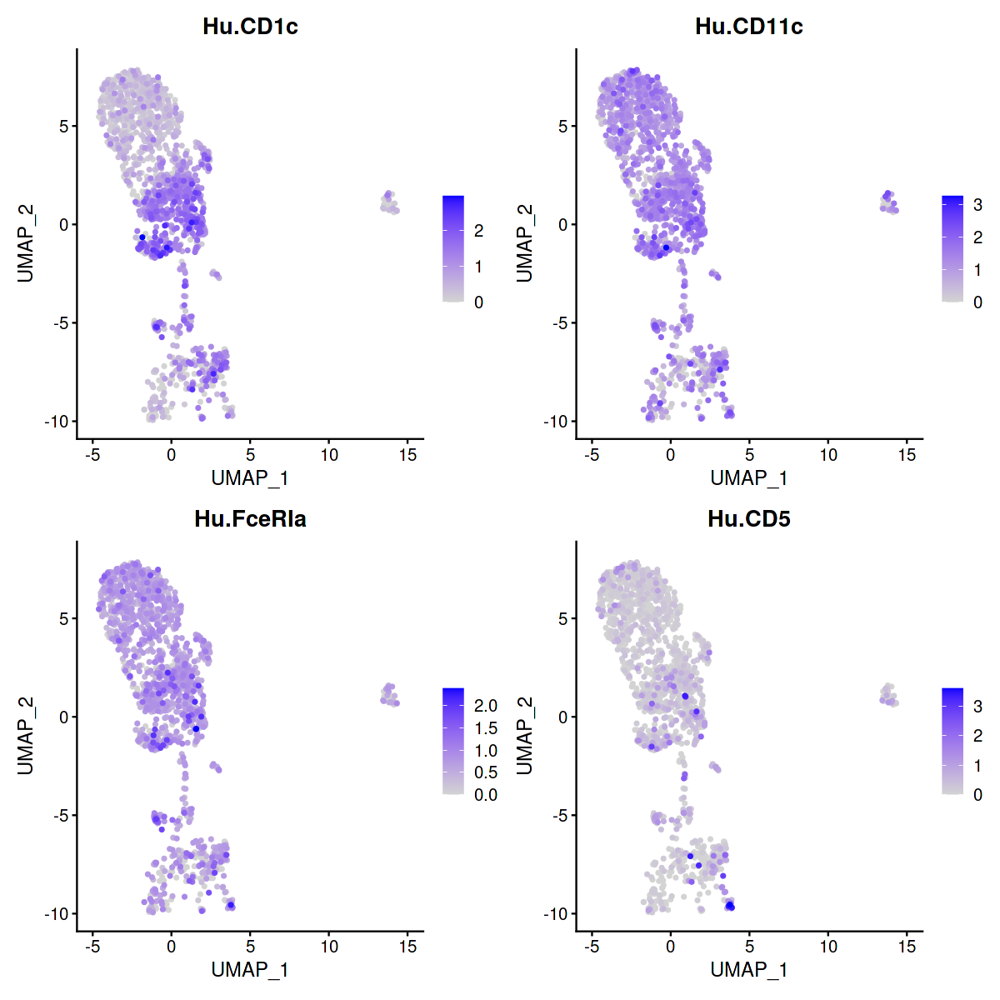

In [102]:
options(repr.plot.width=10, repr.plot.height=10)
FeaturePlot(glasgow3, proteins, order = TRUE)

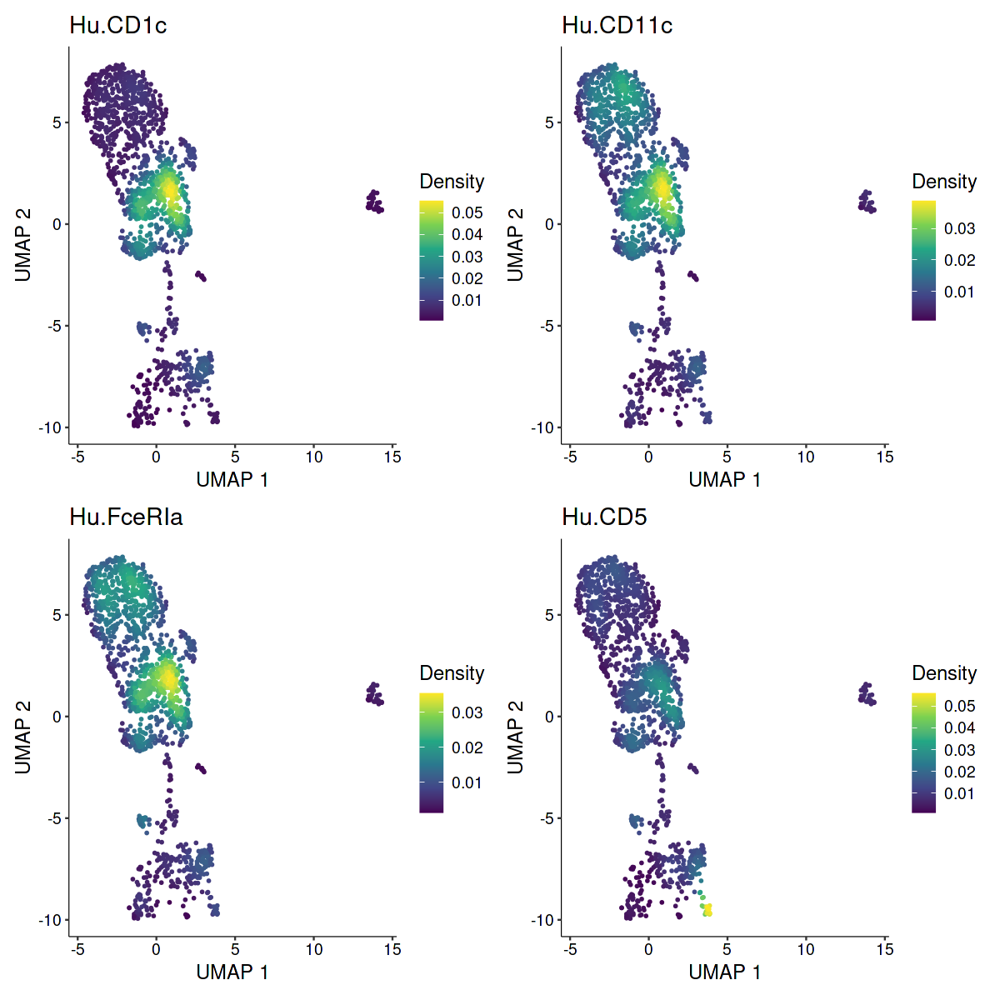

In [103]:
options(repr.plot.width=10, repr.plot.height=10)
plot_density(glasgow3, proteins, reduction="umap")

In [104]:
proteins <- c("Hu.CD63","Hu.CD305-LAIR1","Hu.CD163","Hu.CD36")

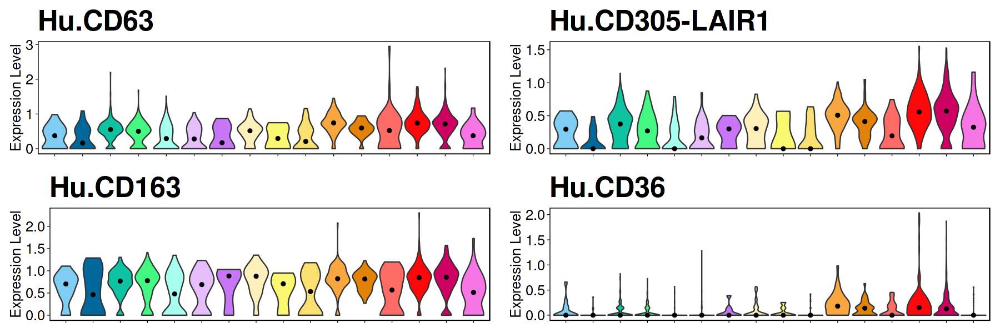

In [105]:
options(repr.plot.width=15, repr.plot.height=5)
x <- list()
DefaultAssay(glasgow3) <- "ADT"
for(protein in proteins){
  x[[protein]] <- VlnPlot(glasgow3, features=protein, pt.size=0,ncol=1, cols=cols) + stat_summary(fun = "median",
               geom = "point", color = "black") + theme_specific + theme(axis.text.x=element_blank(), axis.title.x=element_blank()) + NoLegend() 
}
plot_grid(plotlist=x, ncol=2)

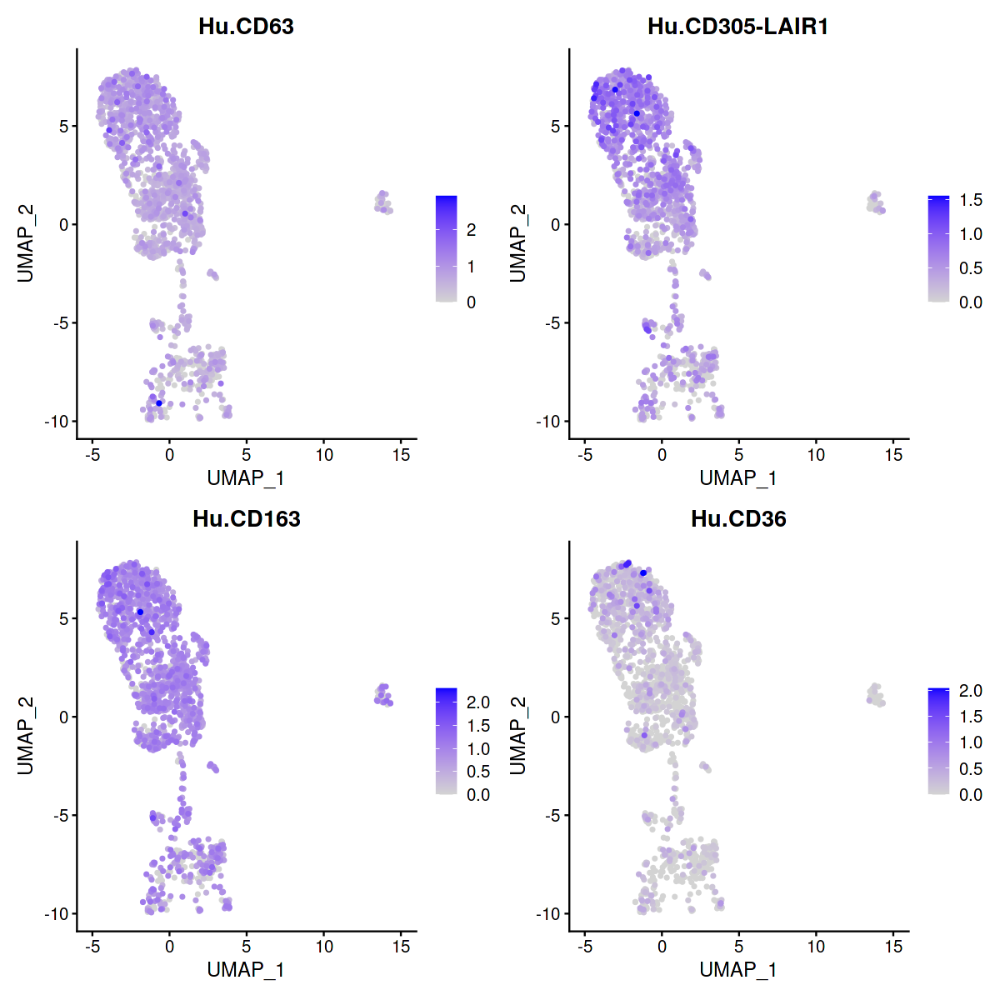

In [106]:
options(repr.plot.width=10, repr.plot.height=10)
FeaturePlot(glasgow3, proteins, order = TRUE)

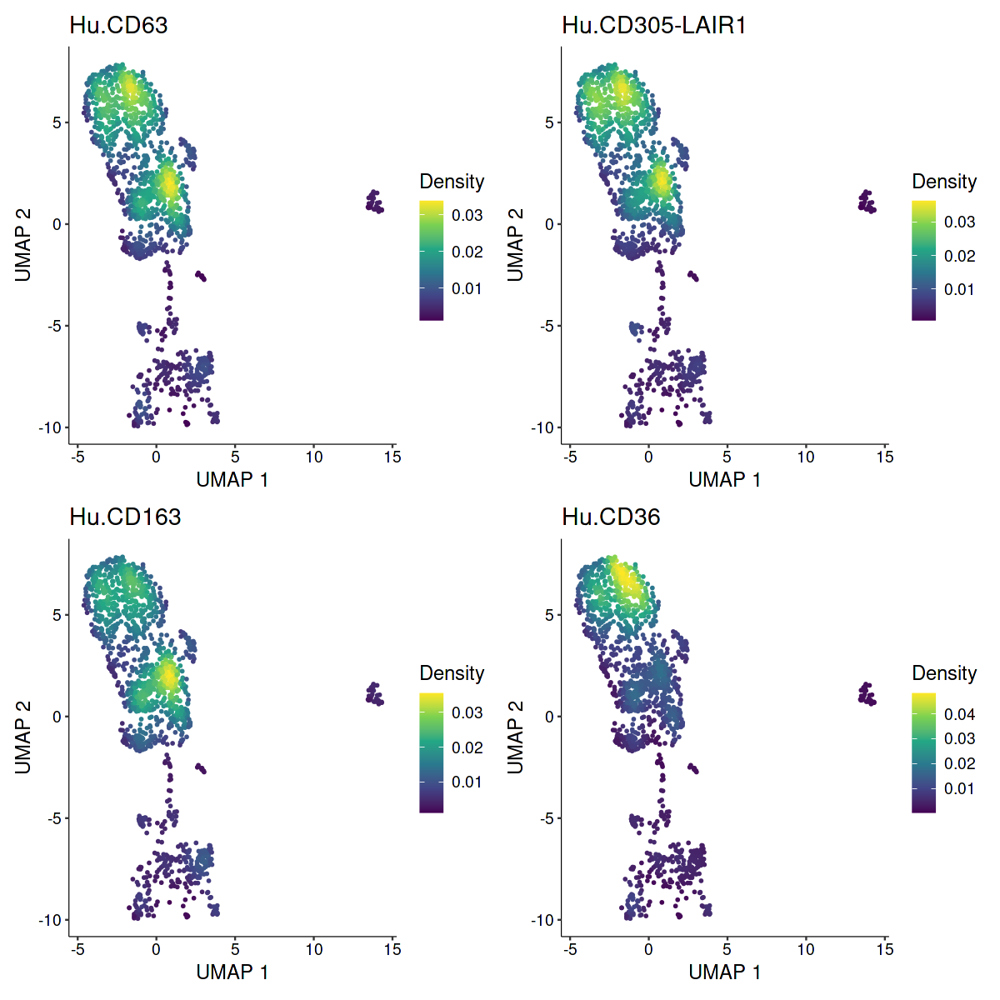

In [107]:
options(repr.plot.width=10, repr.plot.height=10)
plot_density(glasgow3, proteins, reduction="umap")

In [108]:
adt.to.fcs <- function(Seurat.object, filename, ADT.assay.name = "ADT", slot.type = "data") {
library(flowCore)
  adt_data <- as.matrix(GetAssayData(object = Seurat.object, assay = ADT.assay.name, slot = slot.type))
print("ok")
  adt_data <- t(adt_data) 

# Create a flowFrame object from the ADT data
  flow_data <- flowFrame(exprs = adt_data)

  # Create an FCS file from the flowFrame object
  write.FCS(flow_data, filename)

# Read the FCS file
  my_fcs_file <- read.FCS(filename)

  # Check the FCS format
  format(my_fcs_file)
parameters(my_fcs_file)
}

In [127]:
glasgow3$dc.type <- plyr::revalue(as.character(Idents(glasgow3)),
                                        c("iDC3 CD1c-CLEC10A+FOLR2++C1QA+"="iDC3",
                                         "iDC3 CD1c-FABP5+SDS+"="iDC3",
                                        "iDC3 CD1c-CD14lowCD163+ (infiltrating)"="iDC3",
                                         "DC2 CD1c++KLF4+ (infiltrating)"="DC2",
                                         "DC3 CD1clowCD63+CD9+"="DC3",
                                         "DC2 CD1c++AXL+"="DC2",
                                         "DC2 CD1c++KLF4+ATF3+MRC1+"="DC2",
                                         "DC3 CD1c+CD14-CD163+ (infiltrating)"="DC3",
                                         "DC2/3 CD1c+CRIP1+ (transitional)"="DC3",
                                         "DC2 MIR155HG+CCR7+ (activated)"="DC2",
                                         "DC1 CLEC9A+ (infiltrating)"="DC1",
                                         "DC3 CD1clowTUBB4B+TIMP1+"="DC3",
                                         "DC2 CCR7+LAMP3+ (migratory)"="DC2",
                                         "DC2/3 CD1c+ISG15+"="DC3",
                                         "pre-DC CD5+AXL+SIGLEC6+"="pre-DC",
                                         "iDC3 CD1c-CLEC10A+NR4A3+"="iDC3"))

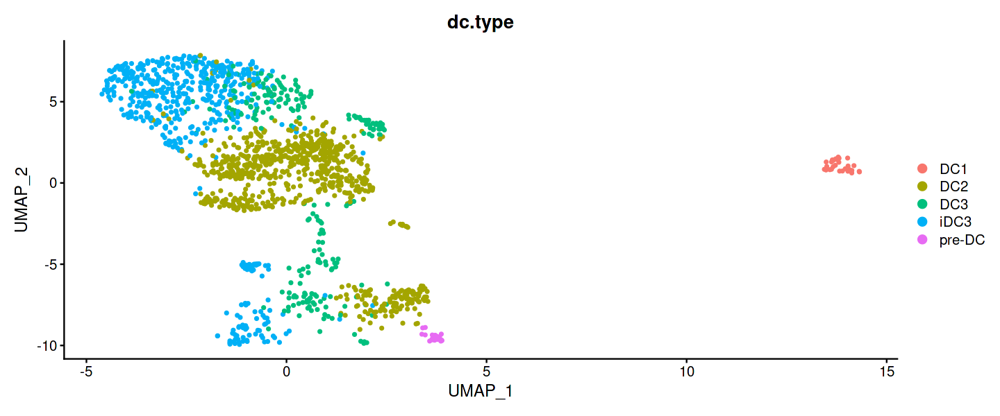

In [128]:
DimPlot(glasgow3, group.by="dc.type")

In [119]:
saveRDS(glasgow3, "glasgow3_dc.only.rds")

## Analysis of CCR7pos DC clusters for Figure 3

In [10]:
CCR7posDC <- subset(dc.only, idents=c("DC2 MIR155HG+CCR7+ (activated)","DC2 CCR7+LAMP3+ (migratory)"))

In [11]:
CCR7mir155vsLamp3 <- FindMarkers(CCR7posDC, ident.1="DC2 MIR155HG+CCR7+ (activated)",ident.2="DC2 CCR7+LAMP3+ (migratory)", test.use="MAST")


 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>----------------------------------------]  10% with 0 failures

 Completed [====>---------------------------------------]  10% with 0 failures

 Completed [====>----------------------

In [12]:
CCR7mir155vsLamp3 <- CCR7mir155vsLamp3[CCR7mir155vsLamp3$p_val_adj<=0.05,]
CCR7mir155vsLamp3 <- CCR7mir155vsLamp3 %>% arrange(desc(avg_log2FC))

In [13]:
write.csv(CCR7mir155vsLamp3, "CCR7mir155vsLamp3.csv")

In [14]:
CCR7posDC.avg <- AverageExpression(CCR7posDC, return.seurat=TRUE, add.ident = "tissue_condition", assay="RNA")

Centering and scaling data matrix



In [15]:
CCR7posDC.avg

An object of class Seurat 
19143 features across 6 samples within 1 assay 
Active assay: RNA (19143 features, 0 variable features)

In [16]:
#Add sample cluster metadata by removing group identity i.e. take info before underscore
CCR7posDC.avg$cluster <-  sub("\\_.*", "", Cells(CCR7posDC.avg))
#Add sample group metadata by removing cluster identity i.e. take info after underscore
CCR7posDC.avg$group <-  gsub(".*\\_", "", Cells(CCR7posDC.avg))
CCR7posDC.avg$group <- as.ordered(factor(CCR7posDC.avg$group, levels=c("Healthy","Active RA","Remission RA")))

In [17]:
CCR7posDC.avg@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,cluster,group
,<fct>,<dbl>,<int>,<chr>,<ord>
DC2 MIR155HG+CCR7+ (activated)_ST_Healthy,DC2 MIR155HG+CCR7+ (activated),10000,11009,DC2 MIR155HG+CCR7+ (activated),Healthy
DC2 MIR155HG+CCR7+ (activated)_ST_Active RA,DC2 MIR155HG+CCR7+ (activated),10000,11489,DC2 MIR155HG+CCR7+ (activated),Active RA
DC2 MIR155HG+CCR7+ (activated)_ST_Remission RA,DC2 MIR155HG+CCR7+ (activated),10000,9875,DC2 MIR155HG+CCR7+ (activated),Remission RA
DC2 CCR7+LAMP3+ (migratory)_ST_Healthy,DC2 CCR7+LAMP3+ (migratory),10000,3367,DC2 CCR7+LAMP3+ (migratory),Healthy
DC2 CCR7+LAMP3+ (migratory)_ST_Active RA,DC2 CCR7+LAMP3+ (migratory),10000,10473,DC2 CCR7+LAMP3+ (migratory),Active RA
DC2 CCR7+LAMP3+ (migratory)_ST_Remission RA,DC2 CCR7+LAMP3+ (migratory),10000,4281,DC2 CCR7+LAMP3+ (migratory),Remission RA


In [18]:
top20 <- as.data.frame(dc.only@misc) %>%
    group_by(cluster) %>%
    slice_max(n = 20, order_by = avg_log2FC)

In [19]:
ccr7markers <- as.data.frame(dc.only@misc)

In [20]:
ccr7markers

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.129028e-48,1.4364558,0.662,0.048,2.161298e-44,pre-DC CD5+AXL+SIGLEC6+,PPP1R14A
2.075779e-46,1.1410722,0.532,0.020,3.973663e-42,pre-DC CD5+AXL+SIGLEC6+,CD5
1.679119e-37,1.5545888,0.662,0.099,3.214338e-33,pre-DC CD5+AXL+SIGLEC6+,SPIB
3.314898e-31,1.2866989,0.584,0.106,6.345710e-27,pre-DC CD5+AXL+SIGLEC6+,C12orf75
1.400702e-27,1.3745206,0.948,0.726,2.681363e-23,pre-DC CD5+AXL+SIGLEC6+,IFITM2
1.199457e-26,-1.6698745,0.792,0.939,2.296120e-22,pre-DC CD5+AXL+SIGLEC6+,NPC2
9.854443e-23,-1.2669599,0.948,0.964,1.886436e-18,pre-DC CD5+AXL+SIGLEC6+,PSAP
4.162101e-21,-2.2191853,0.052,0.564,7.967510e-17,pre-DC CD5+AXL+SIGLEC6+,FCN1
2.013580e-20,1.5376269,0.455,0.091,3.854596e-16,pre-DC CD5+AXL+SIGLEC6+,LTB


In [21]:
ccr7markers <- ccr7markers[which(ccr7markers$cluster==c("DC2 MIR155HG+CCR7+ (activated)","DC2 CCR7+LAMP3+ (migratory)")),]

In [22]:
ccr7markers <- ccr7markers[ccr7markers$p_val_adj<=0.05,]
ccr7markers <- ccr7markers[ccr7markers$avg_log2FC>0,]

In [23]:
write.csv(ccr7markers,"ccr7markers.csv")

In [24]:
#Fetch expression of genes 
matrix <- FetchData(CCR7posDC.avg, vars=unique(ccr7markers$gene), slot="data")
data <- t(matrix)

#Reposition the breaks at the quantiles of the data, then each color will represent an equal proportion of the data:
mat_breaks <- seq(min(data), max(data), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(data, n = 11)

In [25]:
CCR7posDC.avg@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,cluster,group
,<fct>,<dbl>,<int>,<chr>,<ord>
DC2 MIR155HG+CCR7+ (activated)_ST_Healthy,DC2 MIR155HG+CCR7+ (activated),10000,11009,DC2 MIR155HG+CCR7+ (activated),Healthy
DC2 MIR155HG+CCR7+ (activated)_ST_Active RA,DC2 MIR155HG+CCR7+ (activated),10000,11489,DC2 MIR155HG+CCR7+ (activated),Active RA
DC2 MIR155HG+CCR7+ (activated)_ST_Remission RA,DC2 MIR155HG+CCR7+ (activated),10000,9875,DC2 MIR155HG+CCR7+ (activated),Remission RA
DC2 CCR7+LAMP3+ (migratory)_ST_Healthy,DC2 CCR7+LAMP3+ (migratory),10000,3367,DC2 CCR7+LAMP3+ (migratory),Healthy
DC2 CCR7+LAMP3+ (migratory)_ST_Active RA,DC2 CCR7+LAMP3+ (migratory),10000,10473,DC2 CCR7+LAMP3+ (migratory),Active RA
DC2 CCR7+LAMP3+ (migratory)_ST_Remission RA,DC2 CCR7+LAMP3+ (migratory),10000,4281,DC2 CCR7+LAMP3+ (migratory),Remission RA


In [26]:
#Fetch metadata
annotation_col <- as.data.frame(CCR7posDC.avg@meta.data %>% select(cluster, group))
#Set up colour scheme
cluster.cols <- c( "#e5befb","#C876F7")
names(cluster.cols) <- unique(CCR7posDC.avg$cluster)
group.cols <- c("green", "red", "dodgerblue2")
names(group.cols) <- levels(CCR7posDC.avg$group)
metacols <- list(
  cluster = cluster.cols, 
    group = group.cols
)
#Order cells by cluster
data <- data[,order(annotation_col$cluster, annotation_col$group)]

In [41]:
annotation_row <- as.data.frame(mregDCsig$pathway)
rownames(annotation_row) <- mregDCsig$gene
colnames(annotation_row) <- "Pathway"

In [43]:
install.packages("ellipse")

Installing package into ‘/home1/2079424m/R/x86_64-pc-linux-gnu-library/4.1’
(as ‘lib’ is unspecified)



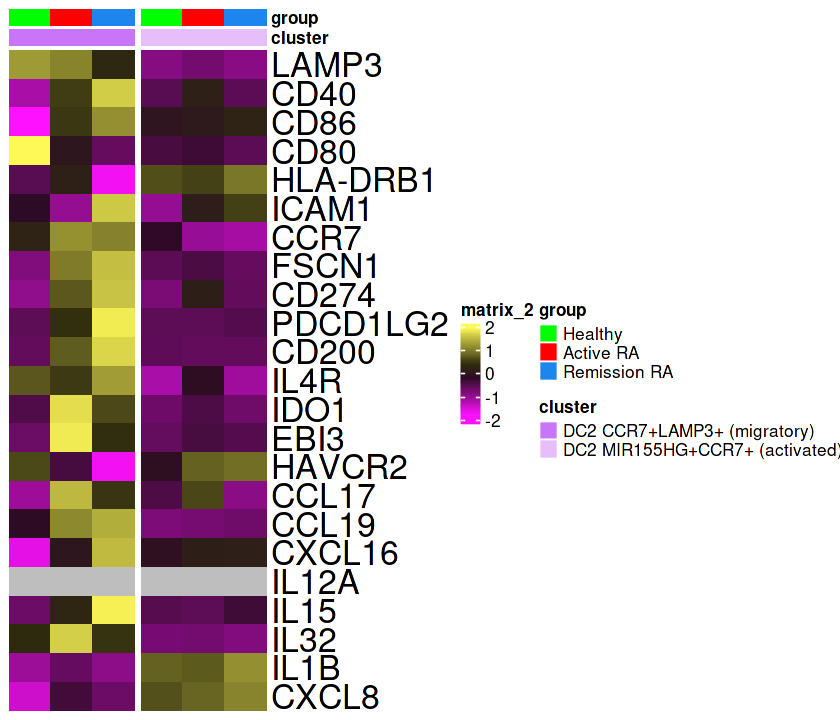

In [45]:
#Scale data
scale_rows <- function(x) t(scale(t(x)))
data <- scale_rows(data) # Z-score
data[data > 2] <- 2
data[data < -2] <- -2

#Generate heatmap
pheatmap(
  mat = data,
  border_color = NA,
  color = colorRampPalette(c("#FE11FF","#0B0801","#FFF957"))(8),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = FALSE,
  cluster_cols = FALSE,
   annotation_col = annotation_col, annotation_colors = metacols, #annotation_row=annotation_row,
  fontsize = 20,
  fontsize_row = 20,
  scale = "none", gaps_col=head(as.numeric(cumsum(table(annotation_col$cluster))), -1)
)

In [28]:
mregDCsig <- read.csv("/home1/2079424m/ElmesmariEtAl-DCPaper/Clustering/mregDCsig.csv")

In [29]:
nrow(mregDCsig)

[1] 23

In [147]:
#Fetch expression of genes 
matrix <- FetchData(CCR7posDC.avg, vars=mregDCsig$gene, slot="data")
data <- t(matrix)

#Reposition the breaks at the quantiles of the data, then each color will represent an equal proportion of the data:
mat_breaks <- seq(min(data), max(data), length.out = 10)
quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs, probs = seq(0, 1, length.out = n))
  breaks[!duplicated(breaks)]
}
mat_breaks <- quantile_breaks(data, n = 11)

In [148]:
CCR7posDC.avg@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,cluster,group
,<fct>,<dbl>,<int>,<chr>,<ord>
DC2 MIR155HG+CCR7+ (activated)_ST_Healthy,DC2 MIR155HG+CCR7+ (activated),10000,11009,DC2 MIR155HG+CCR7+ (activated),Healthy
DC2 MIR155HG+CCR7+ (activated)_ST_Active RA,DC2 MIR155HG+CCR7+ (activated),10000,11489,DC2 MIR155HG+CCR7+ (activated),Active RA
DC2 MIR155HG+CCR7+ (activated)_ST_Remission RA,DC2 MIR155HG+CCR7+ (activated),10000,9875,DC2 MIR155HG+CCR7+ (activated),Remission RA
DC2 CCR7+LAMP3+ (migratory)_ST_Healthy,DC2 CCR7+LAMP3+ (migratory),10000,3367,DC2 CCR7+LAMP3+ (migratory),Healthy
DC2 CCR7+LAMP3+ (migratory)_ST_Active RA,DC2 CCR7+LAMP3+ (migratory),10000,10473,DC2 CCR7+LAMP3+ (migratory),Active RA
DC2 CCR7+LAMP3+ (migratory)_ST_Remission RA,DC2 CCR7+LAMP3+ (migratory),10000,4281,DC2 CCR7+LAMP3+ (migratory),Remission RA


In [149]:
unique(annotation_row$Pathway)

[1] maturation         migration          immunoregulation   cytokine/chemokine
Levels: maturation < migration < immunoregulation < cytokine/chemokine

In [150]:
annotation_row <- as.data.frame(mregDCsig$pathway)
rownames(annotation_row) <- mregDCsig$gene
colnames(annotation_row) <- "Pathway"
annotation_row$Pathway <- as.ordered(factor(annotation_row$Pathway, levels=c('maturation','migration','immunoregulation','cytokine/chemokine')))
row.cols <- c("#6FED5D", "#9D2B4D", "#D2DA5B", "#7448EF")
names(row.cols) <- levels(annotation_row$Pathway)

In [151]:
#Fetch metadata
annotation_col <- as.data.frame(CCR7posDC.avg@meta.data %>% select(cluster, group))
annotation_col$cluster <- as.ordered(factor(annotation_col$cluster, levels=c("DC2 MIR155HG+CCR7+ (activated)","DC2 CCR7+LAMP3+ (migratory)")
#Set up colour scheme
cluster.cols <- c( "#e5befb","#C876F7")
names(cluster.cols) <- unique(annotation_col$cluster)
group.cols <- c("green", "red", "dodgerblue2")
names(group.cols) <- levels(CCR7posDC.avg$group)
metacols <- list(
  cluster = cluster.cols, 
    group = group.cols,
    Pathway = row.cols
)
#Order cells by cluster
data <- data[,order(annotation_col$cluster, annotation_col$group)]
data <- data[order(annotation_row$Pathway),]

ERROR: Error in parse(text = x, srcfile = src): <text>:5:1: unexpected symbol
4: #Set up colour scheme
5: cluster.cols
   ^


In [152]:
annotation_row

,Pathway
,<ord>
LAMP3,maturation
CD40,maturation
CD86,maturation
CD80,maturation
HLA-DRB1,maturation
ICAM1,migration
CCR7,migration
FSCN1,migration
CD274,immunoregulation


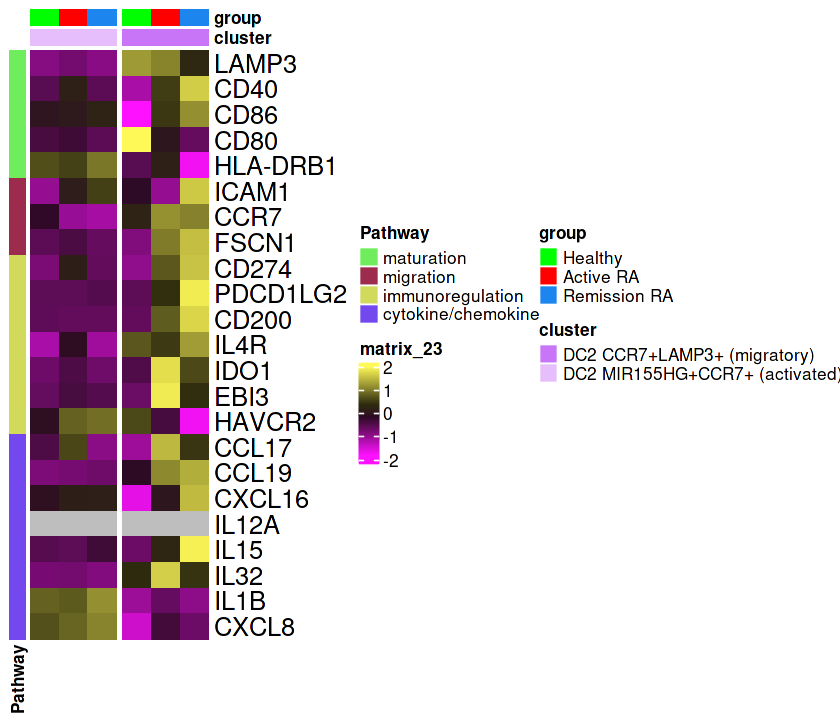

In [153]:
options(repr.plot.width=7, repr.plot.height=6)
#Scale data
scale_rows <- function(x) t(scale(t(x)))
data <- scale_rows(data) # Z-score
data[data > 2] <- 2
data[data < -2] <- -2

#Generate heatmap
pheatmap(
  mat = data,
  border_color = NA,
  color = colorRampPalette(c("#FE11FF","#0B0801","#FFF957"))(8),
  show_rownames = TRUE,
  show_colnames = FALSE,
  cluster_rows = FALSE,
  cluster_cols = FALSE,
   annotation_col = annotation_col, annotation_colors = metacols, annotation_row=annotation_row,
    fontsize = 20,
  fontsize_row = 15,
  scale = "none", gaps_col=head(as.numeric(cumsum(table(annotation_col$cluster))), -1))


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


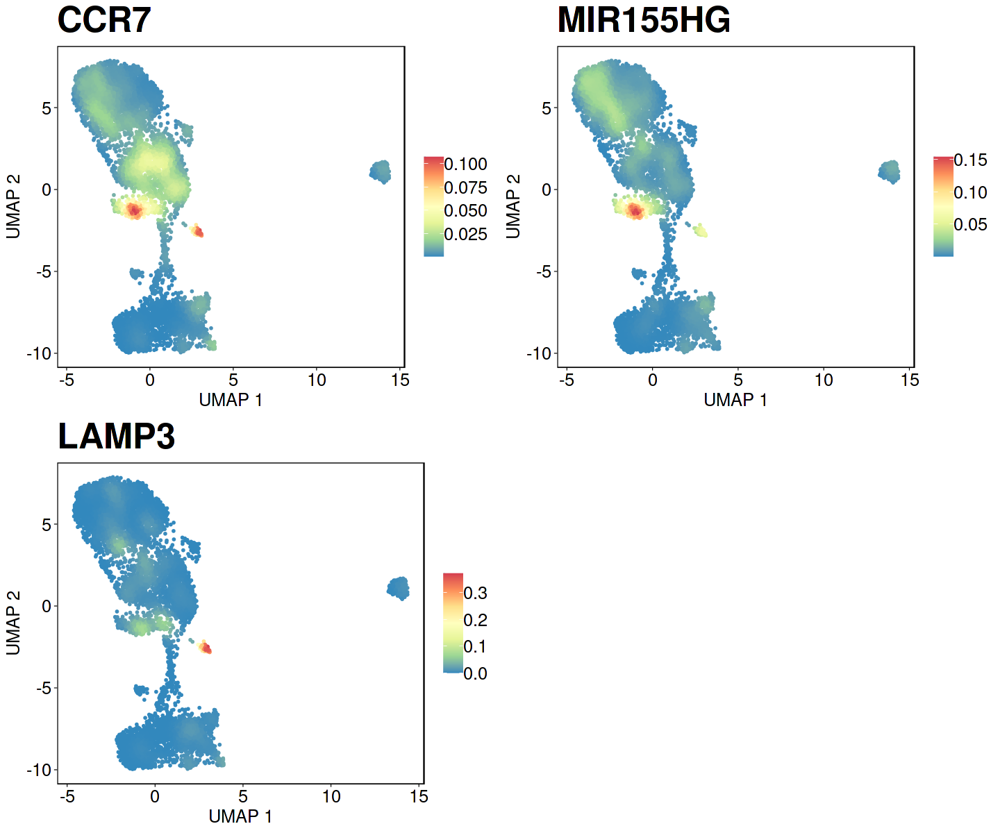

In [15]:
options(repr.plot.width=12, repr.plot.height=10)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0)) + scale_color_distiller(palette = "Spectral")  }

plot_grid(plotlist=x, ncol=2)


In [9]:
genes <- c("CCR7","MIR155HG","LAMP3")

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


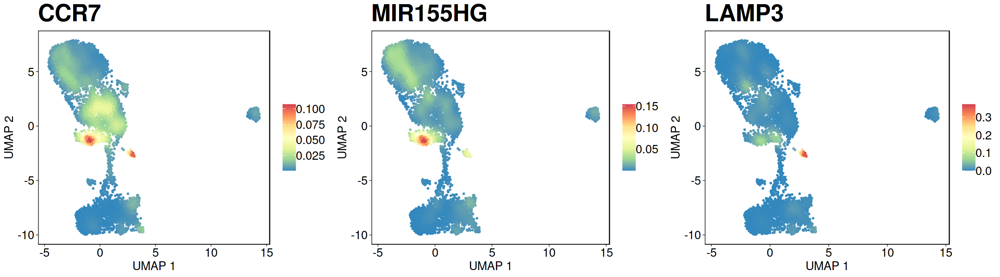

In [16]:
options(repr.plot.width=18, repr.plot.height=5)
x <- list()
for(gene in genes){
  x[[gene]] <- plot_density(dc.only, gene, reduction="umap") + theme_specific + theme(legend.text=element_text(size=15), legend.title=element_text(size=0)) + scale_color_distiller(palette = "Spectral") }

plot_grid(plotlist=x, ncol=3)
